# Networks and Relevant Analysis

### Luxin Tian and Heather Chen

In this notebook we mainly perform LDA topic modeling and network analysis based on that. In the last section of this notebook, a simple text generation task using BERT model is conducted. All the analysis utilizes the United Nation General Debate Corpus. 

In [2]:
import lucem_illud_2020 

import networkx as nx
import sklearn 
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn 
import scipy 
import nltk 

import os

%matplotlib inline

In [3]:
#Load the corpora
file_path = './raw_data/Converted sessions/'
entry_list = []

list_of_folders = os.listdir(file_path)
for session in list_of_folders:
    if not session.startswith('.') and 'Session' in session: 
        list_of_files = os.listdir(file_path + session)
    else: 
        list_of_files = []
    for country in list_of_files: 
        if not country.startswith('.') and '.txt' in country:
            filename = country.split('.')[0].split('_')
            country_code = filename[0]
            session_code = filename[1]
            year_code = filename[2]
            text = open(file_path + session + '/' + country).read()
            entry_list.append(pd.Series({'filename': country, 
                                         'country_code': country_code, 
                                         'session': session_code, 
                                         'year': year_code, 
                                         'text': text}))

ungdc_df = pd.DataFrame(entry_list)

In [4]:
ungdc_df = ungdc_df.sort_values(by=['session', 'country_code'], axis=0, ascending=(True, True))
ungdc_df = ungdc_df.reset_index(drop=True)

In [5]:
ungdc_df

,filename,country_code,session,year,text
0,ALB_25_1970.txt,ALB,25,1970,33: May I first convey to our President the co...
1,ARG_25_1970.txt,ARG,25,1970,177.\t : It is a fortunate coincidence that pr...
2,AUS_25_1970.txt,AUS,25,1970,100.\t It is a pleasure for me to extend to y...
3,AUT_25_1970.txt,AUT,25,1970,155.\t May I begin by expressing to Ambassado...
4,BEL_25_1970.txt,BEL,25,1970,"176. No doubt each of us, before coming up to ..."
...,...,...,...,...,...
8088,WSM_73_2018.txt,WSM,73,2018,I have had the privilege of addressing the G...
8089,YEM_73_2018.txt,YEM,73,2018,On behalf of the Government and the people of ...
8090,ZAF_73_2018.txt,ZAF,73,2018,I have the honour to address the General Assem...
8091,ZMB_73_2018.txt,ZMB,73,2018,Let me join other world leaders in con...


### 1. Topic modeling using LDA model

#### a. Choosing optimal LDA model

In section a we make preparations for further topic modeling. To be specific, we adjust the value of max_df and num_topic to obtain the best LDA model. Here we use UMass coherence score as the criterion for evaluation. 

In [7]:
#First tokenize and normalize the corpora
ungdc_df['tokenized_text'] = ungdc_df['text'].apply(lambda x: lucem_illud_2020.word_tokenize(x))
ungdc_df['normalized_tokens'] = ungdc_df['tokenized_text'].apply(lambda x: lucem_illud_2020.normalizeTokens(x))

In [8]:
ungdc_df

,filename,country_code,session,year,text,tokenized_text,normalized_tokens
0,ALB_25_1970.txt,ALB,25,1970,33: May I first convey to our President the co...,"[33, May, I, first, convey, to, our, President...","[convey, president, congratulation, albanian, ..."
1,ARG_25_1970.txt,ARG,25,1970,177.\t : It is a fortunate coincidence that pr...,"[177, It, is, a, fortunate, coincidence, that,...","[fortunate, coincidence, precisely, time, unit..."
2,AUS_25_1970.txt,AUS,25,1970,100.\t It is a pleasure for me to extend to y...,"[100, It, is, a, pleasure, for, me, to, extend...","[pleasure, extend, mr, president, warm, congra..."
3,AUT_25_1970.txt,AUT,25,1970,155.\t May I begin by expressing to Ambassado...,"[155, May, I, begin, by, expressing, to, Ambas...","[begin, express, ambassador, hambro, behalf, d..."
4,BEL_25_1970.txt,BEL,25,1970,"176. No doubt each of us, before coming up to ...","[176, No, doubt, each, of, us, before, coming,...","[doubt, come, rostrum, wonder, usefulness, fut..."
...,...,...,...,...,...,...,...
8088,WSM_73_2018.txt,WSM,73,2018,I have had the privilege of addressing the G...,"[I, have, had, the, privilege, of, addressing,...","[privilege, address, general, assembly, past, ..."
8089,YEM_73_2018.txt,YEM,73,2018,On behalf of the Government and the people of ...,"[On, behalf, of, the, Government, and, the, pe...","[behalf, government, people, republic, yemen, ..."
8090,ZAF_73_2018.txt,ZAF,73,2018,I have the honour to address the General Assem...,"[I, have, the, honour, to, address, the, Gener...","[honour, address, general, assembly, time, pre..."
8091,ZMB_73_2018.txt,ZMB,73,2018,Let me join other world leaders in con...,"[Let, me, join, other, world, leaders, in, con...","[let, join, world, leader, congratulate, excel..."


In [9]:
#Define a tokenizer to stem words, delete those tokens that contain numbers and less than three characters
import re

def un_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z0-9\-]", " ", str_input).lower().split()
    words = [word for word in words if len(word)>3]
    return words

In [10]:
def dropMissing(wordLst, vocab):
    return [w for w in wordLst if w in vocab]

i. max_df = 0.5 (initial settings)

In [11]:
#Setting max_df = 0.5
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.5, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [12]:
import gensim

dict_all = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_all.doc2bow(text) for text in ungdc_df['reduced_tokens']]
gensim.corpora.MmCorpus.serialize('ungdc.mm', corpus)
unmm = gensim.corpora.MmCorpus('ungdc.mm')

In [13]:
from gensim.models import CoherenceModel


#Compute the coherence score for topic_num from 5 to 40 using u_mass
nums = np.linspace(5,40,36, dtype='int32')
coherence_scores_1 = []
for num in nums:
    unlda_trial = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_all, num_topics=num, alpha='auto', eta='auto')
    coherence_model_lda = CoherenceModel(model=unlda_trial, corpus=unmm, coherence='u_mass')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_scores_1.append(coherence_lda)
    print(num, coherence_lda)


5 -0.6914034617449335
6 -0.619795502199853
7 -0.575347245447369
8 -0.6148094492060703
9 -0.6855518475988762
10 -0.933162162903467
11 -0.6862442107979535
12 -0.6239255177926528
13 -0.8005501136950497
14 -0.681207623890307
15 -0.6778128268781648
16 -0.7665192455363576
17 -0.798341307167432
18 -0.813706024457267
19 -0.7879675096776696
20 -0.7824803070549113
21 -0.8576300729617274
22 -0.7582856154110117
23 -0.8441303111906151
24 -0.770058260047735
25 -0.851110602172792
26 -0.7600814412513603
27 -0.7977791514052973
28 -0.928702240236016
29 -0.751077392293796
30 -0.7492381478650638
31 -0.8355261851679842
32 -0.8050496435181205
33 -0.7307121184383432
34 -0.8961050857258113
35 -0.7775928281107151
36 -0.8394307927853392
37 -0.8030080881802486
38 -0.7906525601198362
39 -0.8059299520575122
40 -0.8492659975605854


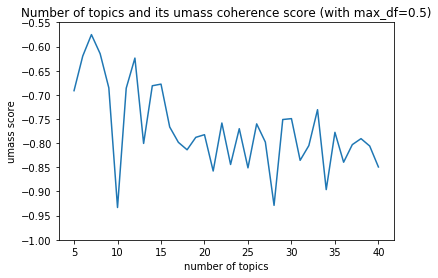

In [14]:
plt.plot(nums, coherence_scores_1)
plt.title('Number of topics and its umass coherence score (with max_df=0.5)')
plt.xlabel('number of topics')
plt.ylabel('umass score')
plt.ylim(-1, -0.55)
plt.show()

Since the lower the u_mass coherence score, the better topic it is, we can see that when setting max_df = 0.5, it is optimal to choose a topic number of 10 or 28. 

ii. max_df = 0.6

In [15]:
#Setting max_df = 0.6
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.6, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [16]:
dict_all = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_all.doc2bow(text) for text in ungdc_df['reduced_tokens']]

In [17]:
nums = np.linspace(5,40,36, dtype='int32')
coherence_scores_2 = []
for num in nums:
    unlda_trial = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_all, num_topics=num, alpha='auto', eta='auto')
    coherence_model_lda = CoherenceModel(model=unlda_trial, corpus=unmm, coherence='u_mass')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_scores_2.append(coherence_lda)
    print(num, coherence_lda)

5 -0.5683428336922042
6 -0.534087196480586
7 -0.7242172841820924
8 -0.727466501932037
9 -0.7007220507301058
10 -0.7372957058781581
11 -0.6552484818544883
12 -0.8232868476605281
13 -0.6882685483706865
14 -0.7094771299829769
15 -0.6649217300339731
16 -0.850677591022436
17 -0.7587282286422298
18 -0.8024519110175361
19 -0.752943720060344
20 -0.8175016498775272
21 -0.7708404135106877
22 -0.8553832006335361
23 -0.776571666098668
24 -0.8301195111144982
25 -0.8732737224596147
26 -0.8128072851725078
27 -0.7836655061219999
28 -0.8484596589673002
29 -0.8440021383309687
30 -0.8992651950936463
31 -0.814006483975027
32 -0.7608707104469633
33 -0.7979693045812865
34 -0.8667602913602965
35 -0.733222725053299
36 -0.834224021207662
37 -0.8806331069203408
38 -0.8039848915128383
39 -0.8052207015465006
40 -0.843822627070713


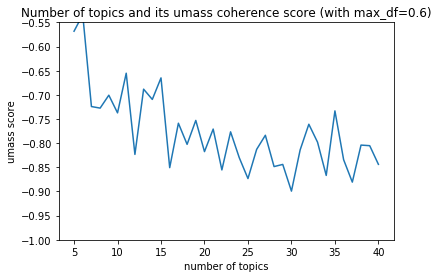

In [18]:
plt.plot(nums, coherence_scores_2)
plt.title('Number of topics and its umass coherence score (with max_df=0.6)')
plt.xlabel('number of topics')
plt.ylabel('umass score')
plt.ylim(-1, -0.55)
plt.show()

Generally speaking, when setting max_df=0.6, we get better outcomes of the same topic numbers compared with setting max_df=0.5. And the optimal topic number is still 33. 

iii. max_df = 0.7

In [19]:
#Setting max_df = 0.7
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.7, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [20]:
dict_all = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_all.doc2bow(text) for text in ungdc_df['reduced_tokens']]

In [21]:
nums = np.linspace(5,40,36, dtype='int32')
coherence_scores_3 = []
for num in nums:
    unlda_trial = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_all, num_topics=num, alpha='auto', eta='auto')
    coherence_model_lda = CoherenceModel(model=unlda_trial, corpus=unmm, coherence='u_mass')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_scores_3.append(coherence_lda)
    print(num, coherence_lda)

5 -0.5794130607010202
6 -0.5949262259524067
7 -0.7236888601098797
8 -0.7391161394680161
9 -0.736217198447095
10 -0.773133765042276
11 -0.6186404940518005
12 -0.708163276661612
13 -0.7187039055828905
14 -0.7274213040520967
15 -0.7470244487637733
16 -0.7396596094438216
17 -0.7925932122707194
18 -0.7274352009207029
19 -0.7394440686309767
20 -0.8336095322183878
21 -0.772565333291877
22 -0.872642669274532
23 -0.7852413489516338
24 -0.7654127160998184
25 -0.8235615293594307
26 -0.8044162217277646
27 -0.7825223598514336
28 -0.7971072329866561
29 -0.7339568464448507
30 -0.7585640883058242
31 -0.7883101388460905
32 -0.8505053062921382
33 -0.8097001832272459
34 -0.834612030669159
35 -0.8064584091248607
36 -0.7872736052725469
37 -0.8668595628717474
38 -0.7916764285352368
39 -0.7503688262121713
40 -0.8656411382874465


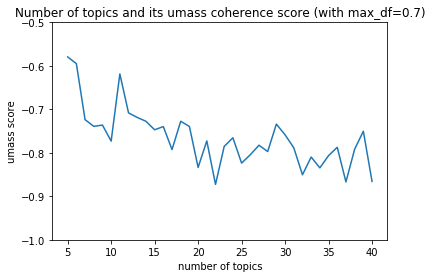

In [22]:
plt.plot(nums, coherence_scores_3)
plt.title('Number of topics and its umass coherence score (with max_df=0.7)')
plt.xlabel('number of topics')
plt.ylabel('umass score')
plt.ylim(-1, -0.5)
plt.show()

iv. max_df = 0.8

In [23]:
#Setting max_df = 0.8
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.8, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [24]:
dict_all = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_all.doc2bow(text) for text in ungdc_df['reduced_tokens']]

In [25]:
nums = np.linspace(5,40,36, dtype='int32')
coherence_scores_4 = []
for num in nums:
    unlda_trial = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_all, num_topics=num, alpha='auto', eta='auto')
    coherence_model_lda = CoherenceModel(model=unlda_trial, corpus=unmm, coherence='u_mass')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_scores_4.append(coherence_lda)
    print(num, coherence_lda)

5 -0.5847345549156522
6 -0.6698388755670798
7 -0.5945178793466047
8 -0.7876434774276203
9 -0.6916073652983528
10 -0.633820716252335
11 -0.7368172149068305
12 -0.7487141683855622
13 -0.7125062380969669
14 -0.7161014495961476
15 -0.7565047526155773
16 -0.8944303851146295
17 -0.7019009106661793
18 -0.8313880172085054
19 -0.7707179477803047
20 -0.829985225450617
21 -0.8000276071670498
22 -0.8034031481981653
23 -0.8803274577176111
24 -0.8659423852655864
25 -0.8460436287496249
26 -0.7239858970192595
27 -0.812450823967231
28 -0.8300915457200261
29 -0.7888935562751035
30 -0.7355369584468467
31 -0.7730242623478382
32 -0.8182748661650441
33 -0.7756653939528522
34 -0.815507079017463
35 -0.8413780989376859
36 -0.8434803540134697
37 -0.8067136271248904
38 -0.7856957299356364
39 -0.8143493869548065
40 -0.7776628542528767


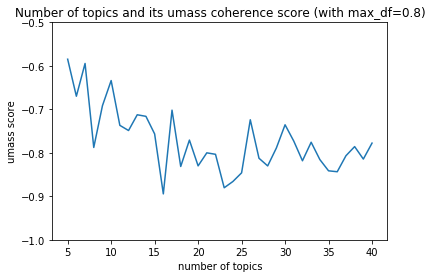

In [26]:
plt.plot(nums, coherence_scores_4)
plt.title('Number of topics and its umass coherence score (with max_df=0.8)')
plt.xlabel('number of topics')
plt.ylabel('umass score')
plt.ylim(-1, -0.5)
plt.show()

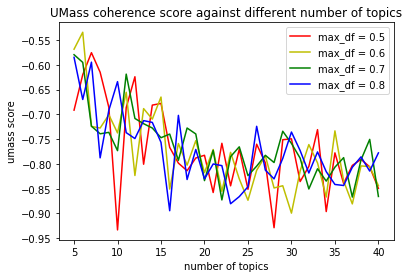

In [172]:
#Plot these graphs together
plt.plot(figsize=(10,8))
plt.plot(nums, coherence_scores_1, color='r', label='max_df = 0.5')
plt.plot(nums, coherence_scores_2, color='y', label='max_df = 0.6')
plt.plot(nums, coherence_scores_3, color='g', label='max_df = 0.7')
plt.plot(nums, coherence_scores_4, color='b', label='max_df = 0.8')
plt.title('UMass coherence score against different number of topics')
plt.xlabel('number of topics')
plt.ylabel('umass score')
plt.legend(loc='best')
plt.savefig('./pic/umass_score.png', format='PNG')
plt.show()

As we can see from the graph, the u_mass number is the best when number of topics=10 (or num_topic = 28) and max_df = 0.5.

#### b. Using optimal number of topics and max_df to construct topic modeling

In the former section we can see the best LDA model is achieved when setting max_df = 0.5. However, we need to further examine which num_topic has the best interpretability. 

In [28]:
#First trial for setting max_df = 0.5 and number of topics = 10. 
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.5, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [29]:
dict_all = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_all.doc2bow(text) for text in ungdc_df['reduced_tokens']]

In [30]:
unlda_opt = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_all, num_topics=10, alpha='auto', eta='auto')

In [31]:
topics_dict = {}
for topic_num in range(unlda_opt.num_topics):
    topic_words = [w for w, p in unlda_opt.show_topic(topic_num)]
    topics_dict['Topic_{}'.format(topic_num)] = topic_words

word_ranks_df = pd.DataFrame(topics_dict)
word_ranks_df

,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5,Topic_6,Topic_7,Topic_8,Topic_9
0,nation,nation,nation,nation,unite,nation,nation,nation,unite,nation
1,unite,unite,unite,unite,nation,unite,unite,unite,nation,unite
2,challenge,principle,terrorism,sustainable,korea,build,principle,arab,live,reform
3,small,operation,israel,climate,relation,ukraine,strengthen,morocco,society,challenge
4,principle,delegation,syria,challenge,korean,trinidad,democracy,iraq,migration,sudan
5,sustainable,bahamas,terrorist,island,viet,tobago,weapon,principle,dignity,sustainable
6,climate,relation,palestinian,reform,peninsula,union,american,palestinian,child,union
7,live,weapon,syrian,goal,principle,venezuela,paraguay,base,lead,goal
8,goal,area,sudan,address,operation,challenge,determination,tunisia,woman,hold
9,reform,power,yemen,include,build,principle,panama,terrorism,principle,lead


In [32]:
#Next try setting max_df = 0.5 and number of topics = 28. 
un_tfvectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.5, min_df=10, stop_words='english', tokenizer=un_tokenizer)
un_tfvects = un_tfvectorizer.fit_transform(ungdc_df['text'])
ungdc_df['reduced_tokens'] = ungdc_df['normalized_tokens'].apply(lambda x: dropMissing(x, un_tfvectorizer.vocabulary_.keys()))

In [33]:
dict_opt = gensim.corpora.Dictionary(ungdc_df['reduced_tokens'])
corpus = [dict_opt.doc2bow(text) for text in ungdc_df['reduced_tokens']]

In [34]:
unlda_opt = gensim.models.ldamodel.LdaModel(corpus=unmm, id2word=dict_opt, num_topics=28, alpha='auto', eta='auto')

In [35]:
topics_dict = {}
for topic_num in range(unlda_opt.num_topics):
    topic_words = [w for w, p in unlda_opt.show_topic(topic_num)]
    topics_dict['Topic_{}'.format(topic_num)] = topic_words

word_ranks_df = pd.DataFrame(topics_dict)
word_ranks_df.iloc[:10, :10]

,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5,Topic_6,Topic_7,Topic_8,Topic_9
0,malta,unite,unite,chad,unite,unite,nation,nation,unite,unite
1,nation,nation,syria,nation,venezuela,nation,unite,unite,nation,nation
2,unite,afghanistan,israel,paraguay,nation,determination,sustainable,union,mongolia,mauritius
3,mediterranean,principle,nation,unite,nicaragua,power,challenge,reform,relation,philippines
4,ethiopia,affordable,palestinian,guinea,bolivarian,self,goal,strengthen,principle,live
5,power,secretary,terrorism,live,america,operation,reform,european,increase,increase
6,principle,lebanon,syrian,principle,latin,principle,address,secretary,initiative,ocean
7,relation,terrorism,yemen,solidarity,american,relation,climate,weapon,operation,principle
8,delegation,challenge,arab,principe,attempt,measure,strengthen,programme,area,chagos
9,operation,meet,terrorist,lead,sovereignty,regime,secretary,challenge,reform,lead


In [36]:
word_ranks_df.iloc[:10, 10:20]

,Topic_10,Topic_11,Topic_12,Topic_13,Topic_14,Topic_15,Topic_16,Topic_17,Topic_18,Topic_19
0,nation,unite,nation,morocco,unite,nation,sudan,unite,unite,nation
1,unite,nation,unite,nation,nation,unite,unite,nation,nation,unite
2,live,sahel,malawi,unite,turkey,island,nation,sustainable,ukraine,sustainable
3,society,sudan,weapon,albania,leste,climate,lead,challenge,weapon,include
4,fight,mali,power,mohammed,timor,pacific,drug,reform,ukrainian,japan
5,woman,tanzania,canada,kingdom,greece,sustainable,libya,strengthen,russia,challenge
6,challenge,lake,delegation,king,determination,small,terrorism,goal,central,live
7,cent,niger,operation,relation,european,challenge,democracy,include,crimea,reform
8,child,hold,reform,union,union,ocean,initiative,terrorism,principle,climate
9,sustainable,refugee,initiative,european,portugal,address,arab,address,strengthen,goal


In [37]:
word_ranks_df.iloc[:10, 20:28]

,Topic_20,Topic_21,Topic_22,Topic_23,Topic_24,Topic_25,Topic_26,Topic_27
0,nation,nation,unite,iraq,unite,unite,nation,nation
1,unite,unite,nation,unite,korea,nation,unite,solomon
2,suriname,terrorist,small,nation,korean,viet,romania,unite
3,poland,pakistan,climate,iran,peninsula,china,operation,island
4,principle,terrorism,sustainable,arab,nation,asean,relation,tonga
5,panama,stand,challenge,iraqi,statement,singapore,arab,ireland
6,base,live,tobago,palestinian,relation,power,power,weapon
7,power,attack,trinidad,principle,build,korea,principle,principle
8,weapon,want,caribbean,kuwait,joint,chinese,regime,climate
9,relation,power,address,relation,bulgaria,korean,mean,small


When we set topic_num=28, it captures more information than setting topic_num=10. So we go on to set topic_num=28.

#### c. How topics has evloved during time

In this section, we examine how certain topics' probabilities have evloved over time. 

In [189]:
#Firstly, we need to aggregate annual texts regardless of countries.
years = np.arange(1970, 2019, 1)
prob_by_year_df = pd.DataFrame(columns=['year', 'reduced_tokens'])
for year in years:
    temp_dict = {}
    temp_df = ungdc_df.loc[ungdc_df['year']==str(year)]
    agg_reduced_tokens = temp_df['reduced_tokens'].sum()
    temp_dict['year'] = str(year)
    temp_dict['reduced_tokens'] = agg_reduced_tokens
    prob_by_year_df = prob_by_year_df.append(temp_dict, ignore_index=True)
    
prob_by_year_df

,year,reduced_tokens
0,1970,"[convey, congratulation, albanian, delegation,..."
1,1971,"[outset, congratulate, esteem, post, congratul..."
2,1972,"[behalf, afghan, delegation, extend, warm, con..."
3,1973,"[pleasure, congratulate, delegation, afghanist..."
4,1974,"[permit, convey, congratulation, delegation, a..."
5,1975,"[pleasure, delegation, afghanistan, elect, cer..."
6,1976,"[pleasure, behalf, delegation, extend, warm, c..."
7,1977,"[behalf, delegation, afghanistan, join, repres..."
8,1978,"[address, convey, love, nation, represent, fra..."
9,1979,"[tradition, begin, statement, tribute, office,..."


In [190]:
#Then generate a dataframe to hold probabilities of all topics on each year.
lda_byear_df = pd.DataFrame({
        'year' : prob_by_year_df['year'],
        'topics' : [unlda_opt[dict_opt.doc2bow(l)] for l in prob_by_year_df['reduced_tokens']]
    })

In [191]:
#Dict to temporally hold the probabilities
topics_prob_dict_byear = {i : [0] * len(lda_byear_df) for i in range(unlda_opt.num_topics)}

#Load them into the dict
for index, topic_tuples in enumerate(lda_byear_df['topics']):
    for topic_num, prob in topic_tuples:
        topics_prob_dict_byear[topic_num][index] = prob

#Update the DataFrame
for topic_num in range(unlda_opt.num_topics):
    lda_byear_df['topic_{}'.format(topic_num)] = topics_prob_dict_byear[topic_num]

lda_byear_df

,year,topics,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,...,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,topic_24,topic_25,topic_26,topic_27
0,1970,"[(5, 0.78544265), (8, 0.025774978), (9, 0.0123...",0.000000,0.000000,0.000000,0.000000,0.000000,0.785443,0.000000,0.000000,...,0.019380,0.000000,0.036521,0.030633,0.000000,0.000000,0.000000,0.014856,0.013789,0.000000
1,1971,"[(2, 0.014626856), (5, 0.73081905), (8, 0.0195...",0.000000,0.000000,0.014627,0.000000,0.000000,0.730819,0.000000,0.000000,...,0.000000,0.000000,0.023277,0.038288,0.000000,0.000000,0.000000,0.060102,0.026087,0.000000
2,1972,"[(0, 0.011130911), (1, 0.012370797), (5, 0.700...",0.011131,0.012371,0.000000,0.000000,0.000000,0.700073,0.000000,0.000000,...,0.013679,0.000000,0.031152,0.048154,0.000000,0.000000,0.000000,0.026390,0.043226,0.000000
3,1973,"[(4, 0.012688486), (5, 0.6857208), (8, 0.03969...",0.000000,0.000000,0.000000,0.000000,0.012688,0.685721,0.000000,0.000000,...,0.012051,0.000000,0.037672,0.035717,0.000000,0.000000,0.000000,0.031400,0.052158,0.000000
4,1974,"[(0, 0.01234633), (3, 0.01835331), (4, 0.01090...",0.012346,0.000000,0.000000,0.018353,0.010901,0.735720,0.000000,0.000000,...,0.000000,0.000000,0.020227,0.000000,0.000000,0.000000,0.000000,0.000000,0.068391,0.000000
5,1975,"[(0, 0.010372805), (3, 0.01684292), (5, 0.7152...",0.010373,0.000000,0.000000,0.016843,0.000000,0.715275,0.000000,0.000000,...,0.000000,0.000000,0.029900,0.000000,0.000000,0.000000,0.000000,0.024649,0.078541,0.000000
6,1976,"[(0, 0.018649802), (1, 0.04096251), (5, 0.6887...",0.018650,0.040963,0.000000,0.000000,0.000000,0.688768,0.000000,0.000000,...,0.000000,0.000000,0.024462,0.010576,0.000000,0.000000,0.000000,0.010537,0.104461,0.000000
7,1977,"[(0, 0.014388821), (1, 0.041762136), (2, 0.014...",0.014389,0.041762,0.014764,0.000000,0.000000,0.623411,0.000000,0.011097,...,0.000000,0.000000,0.041303,0.000000,0.000000,0.014207,0.000000,0.012275,0.123753,0.000000
8,1978,"[(0, 0.016508995), (1, 0.035238527), (4, 0.011...",0.016509,0.035239,0.000000,0.000000,0.011287,0.594183,0.000000,0.013963,...,0.000000,0.000000,0.041097,0.000000,0.000000,0.013250,0.000000,0.000000,0.133847,0.023784
9,1979,"[(0, 0.014036599), (1, 0.06782408), (3, 0.0127...",0.014037,0.067824,0.000000,0.012720,0.015920,0.580975,0.000000,0.000000,...,0.000000,0.000000,0.030770,0.016792,0.000000,0.020172,0.000000,0.022067,0.113354,0.000000


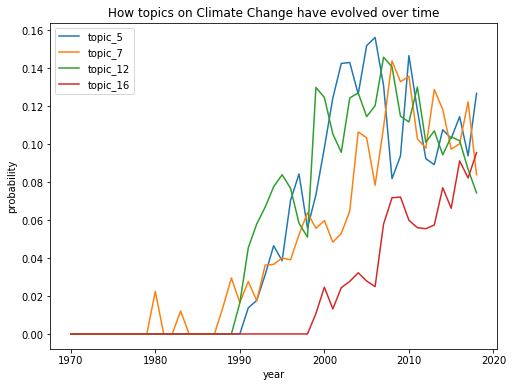

In [204]:
#Here we select all topics related to climate change, topic labels are according to the topic labels in pyLDAvis.
plt.figure(figsize=(8, 6))
plt.plot(years, lda_byear_df.loc[:, 'topic_6'], label='topic_5')
plt.plot(years, lda_byear_df.loc[:, 'topic_22'], label='topic_7')
plt.plot(years, lda_byear_df.loc[:, 'topic_19'], label='topic_12')
plt.plot(years, lda_byear_df.loc[:, 'topic_15'], label='topic_16')
plt.title('How topics on Climate Change have evolved over time')
plt.xlabel('year')
plt.ylabel('probability')
plt.legend(loc='best')
plt.savefig('./pic/topic_climate.png', format='PNG')

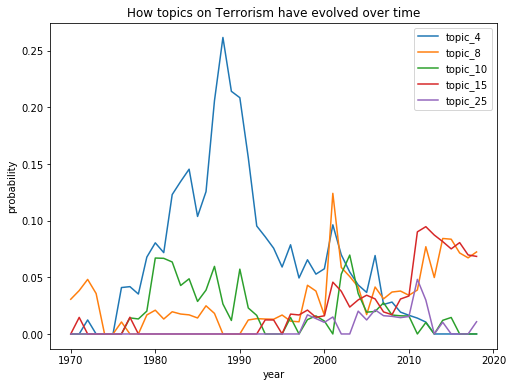

In [205]:
#Now we look at the topics related to terrorism.
plt.figure(figsize=(8, 6))
plt.plot(years, lda_byear_df.loc[:, 'topic_1'], label='topic_4')
plt.plot(years, lda_byear_df.loc[:, 'topic_21'], label='topic_8')
plt.plot(years, lda_byear_df.loc[:, 'topic_23'], label='topic_10')
plt.plot(years, lda_byear_df.loc[:, 'topic_2'], label='topic_15')
plt.plot(years, lda_byear_df.loc[:, 'topic_16'], label='topic_25')
plt.title('How topics on Terrorism have evolved over time')
plt.xlabel('year')
plt.ylabel('probability')
plt.legend(loc='best')
plt.savefig('./pic/topic_terrorism.png', format='PNG')

#### d. State preferences using topic modeling

In this section we examine our results in LDA model from another perspective. Here we try to investigate the discrepencies on countries topics of interest.

In [264]:
#First, we aggregate the corpus by country name.
ungdc2018_df = ungdc_df.loc[ungdc_df['year']=='2018']
con_list = list(ungdc2018_df['country_code'])

prob_by_con_df = pd.DataFrame(columns=['country', 'reduced_tokens'])
for country in con_list:
    temp_dict = {}
    temp_df = ungdc_df.loc[ungdc_df['country_code']==country]
    agg_reduced_tokens = temp_df['reduced_tokens'].sum()
    temp_dict['country'] = country
    temp_dict['reduced_tokens'] = agg_reduced_tokens
    prob_by_con_df = prob_by_con_df.append(temp_dict, ignore_index=True)
    
prob_by_con_df

,country,reduced_tokens
0,AFG,"[outset, congratulate, esteem, post, congratul..."
1,AGO,"[young, angola, historically, officially, admi..."
2,ALB,"[convey, congratulation, albanian, delegation,..."
3,AND,"[presidency, mark, moment, entire, continent, ..."
4,ARE,"[pleasure, extend, congratulation, delegation,..."
...,...,...
191,WSM,"[extend, warm, congratulation, samoa, delegati..."
192,YEM,"[pleasure, extend, behalf, delegation, congrat..."
193,ZAF,"[delegation, extend, rostrum, warm, congratula..."
194,ZMB,"[associate, delegation, sentiment, congratulat..."


In [265]:
#Then generate a dataframe to hold probabilities for each country across all years.
lda_bcon_df = pd.DataFrame({
        'country' : prob_by_con_df['country'],
        'topics' : [unlda_opt[dict_opt.doc2bow(l)] for l in prob_by_con_df['reduced_tokens']]
    })

In [266]:
#Dict to temporally hold the probabilities
topics_prob_dict_bcon = {i : [0] * len(lda_bcon_df) for i in range(unlda_opt.num_topics)}

#Load them into the dict
for index, topic_tuples in enumerate(lda_bcon_df['topics']):
    for topic_num, prob in topic_tuples:
        topics_prob_dict_bcon[topic_num][index] = prob

#Update the DataFrame
for topic_num in range(unlda_opt.num_topics):
    lda_bcon_df['topic_{}'.format(topic_num)] = topics_prob_dict_bcon[topic_num]

lda_bcon_df

,country,topics,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,...,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,topic_24,topic_25,topic_26,topic_27
0,AFG,"[(1, 0.5910666), (5, 0.048512135), (7, 0.01708...",0.0,0.591067,0.000000,0.000000,0.000000,0.048512,0.000000,0.017085,...,0.019393,0.000000,0.000000,0.241987,0.000000,0.016015,0.0,0.000000,0.010616,0.000000
1,AGO,"[(1, 0.010804744), (3, 0.030980876), (4, 0.030...",0.0,0.010805,0.000000,0.030981,0.030146,0.501512,0.016317,0.041791,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.019979,0.0,0.000000,0.034372,0.000000
2,ALB,"[(4, 0.028103027), (5, 0.19033514), (8, 0.0260...",0.0,0.000000,0.000000,0.000000,0.028103,0.190335,0.000000,0.000000,...,0.072382,0.000000,0.000000,0.068627,0.000000,0.042562,0.0,0.051159,0.074633,0.000000
3,AND,"[(5, 0.052949272), (6, 0.016105402), (7, 0.028...",0.0,0.000000,0.000000,0.000000,0.000000,0.052949,0.016105,0.028823,...,0.000000,0.197039,0.013769,0.084286,0.010837,0.000000,0.0,0.000000,0.000000,0.000000
4,ARE,"[(1, 0.19948508), (2, 0.12041205), (5, 0.04607...",0.0,0.199485,0.120412,0.000000,0.000000,0.046071,0.013808,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.566585,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
191,WSM,"[(1, 0.092434), (5, 0.13197626), (6, 0.0214362...",0.0,0.092434,0.000000,0.000000,0.000000,0.131976,0.021436,0.041538,...,0.010354,0.102296,0.000000,0.011414,0.047853,0.000000,0.0,0.000000,0.000000,0.019918
192,YEM,"[(1, 0.09244981), (2, 0.3155874), (5, 0.181811...",0.0,0.092450,0.315587,0.000000,0.000000,0.181811,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.303364,0.0,0.000000,0.020971,0.000000
193,ZAF,"[(1, 0.03545404), (5, 0.26239112), (6, 0.25707...",0.0,0.035454,0.000000,0.000000,0.000000,0.262391,0.257074,0.052655,...,0.000000,0.108532,0.000000,0.022464,0.050499,0.000000,0.0,0.000000,0.000000,0.000000
194,ZMB,"[(1, 0.06701355), (5, 0.50878805), (6, 0.24140...",0.0,0.067014,0.000000,0.000000,0.000000,0.508788,0.241409,0.012601,...,0.000000,0.000000,0.000000,0.000000,0.038035,0.000000,0.0,0.000000,0.045624,0.000000


In [267]:
#Rename topic names to match those in pyLDAvis
lda_bcon_df = lda_bcon_df.rename(columns={'topic_0': 'topic_28', 'topic_1': 'topic_4', 'topic_2': 'topic_15', 'topic_3': 'topic_14',
                                          'topic_4': 'topic_20', 'topic_5': 'topic_1', 'topic_6': 'topic_5', 'topic_7': 'topic_3', 
                                          'topic_8': 'topic_13', 'topic_9': 'topic_24', 'topic_10': 'topic_6', 'topic_11': 'topic_17',
                                          'topic_12': 'topic_19', 'topic_13': 'topic_27', 'topic_14': 'topic_23', 'topic_15': 'topic_16',
                                          'topic_16': 'topic_25', 'topic_17': 'topic_2','topic_18': 'topic_18', 'topic_19': 'topic_12',
                                          'topic_20': 'topic_11', 'topic_21': 'topic_8', 'topic_22': 'topic_7', 'topic_23': 'topic_10',
                                          'topic_24': 'topic_26', 'topic_25': 'topic_21', 'topic_26': 'topic_9', 'topic_27': 'topic_22'})

top_topic_bcon_df = pd.DataFrame(columns=['country', 'top_1', 'top_2', 'top_3', 'top_4', 'top_5'])

In [268]:
#The top 5 discussed topic for each country. 
for country in con_list:
    temp_dict = {}
    temp_dict['country'] = country
    con_df = lda_bcon_df.loc[lda_bcon_df['country']==country]
    temp_df = con_df.drop(['country', 'topics'], axis=1)
    temp_list = list(chain(*np.ndarray.tolist(temp_df.values)))
    max_list = sorted(temp_list, reverse=True)
    for index in range(5):
        col_name = con_df.columns[(con_df == max_list[index]).iloc[0]][0]
        temp_dict['top_'+str(index+1)] = col_name
    top_topic_bcon_df = top_topic_bcon_df.append(temp_dict, ignore_index=True)
    
top_topic_bcon_df

,country,top_1,top_2,top_3,top_4,top_5
0,AFG,topic_4,topic_8,topic_1,topic_18,topic_3
1,AGO,topic_1,topic_17,topic_23,topic_3,topic_9
2,ALB,topic_27,topic_1,topic_9,topic_18,topic_8
3,AND,topic_6,topic_12,topic_2,topic_8,topic_1
4,ARE,topic_10,topic_4,topic_15,topic_1,topic_5
...,...,...,...,...,...,...
191,WSM,topic_16,topic_1,topic_12,topic_4,topic_7
192,YEM,topic_15,topic_10,topic_1,topic_4,topic_9
193,ZAF,topic_1,topic_5,topic_12,topic_6,topic_3
194,ZMB,topic_1,topic_5,topic_4,topic_9,topic_7


In [306]:
#Latex representation
print(top_topic_bcon_df.to_latex(index=False))

\begin{tabular}{llllll}
\toprule
country &     top\_1 &     top\_2 &     top\_3 &     top\_4 &     top\_5 \\
\midrule
    AFG &   topic\_4 &   topic\_8 &   topic\_1 &  topic\_18 &   topic\_3 \\
    AGO &   topic\_1 &  topic\_17 &  topic\_23 &   topic\_3 &   topic\_9 \\
    ALB &  topic\_27 &   topic\_1 &   topic\_9 &  topic\_18 &   topic\_8 \\
    AND &   topic\_6 &  topic\_12 &   topic\_2 &   topic\_8 &   topic\_1 \\
    ARE &  topic\_10 &   topic\_4 &  topic\_15 &   topic\_1 &   topic\_5 \\
    ARG &  topic\_11 &   topic\_1 &  topic\_20 &  topic\_14 &   topic\_6 \\
    ARM &   topic\_2 &   topic\_8 &   topic\_1 &  topic\_23 &   topic\_3 \\
    ATG &   topic\_7 &   topic\_1 &   topic\_6 &   topic\_8 &  topic\_12 \\
    AUS &   topic\_3 &   topic\_1 &   topic\_2 &  topic\_16 &   topic\_4 \\
    AUT &   topic\_2 &  topic\_13 &   topic\_3 &  topic\_18 &  topic\_22 \\
    AZE &   topic\_2 &  topic\_13 &  topic\_10 &  topic\_18 &  topic\_15 \\
    BDI &   topic\_1 &  topic\_17 &   topic\_6

In [274]:
top_topic_bcon_df.to_csv('./pic/top_topics_all.csv')

In [300]:
#Now we try to focus on countries whose GDP rank top 20 in 2019.
gdp_top_20 = ['USA', 'CHN', 'JPN', 'GER', 'IND', 'GBR', 'FRA', 'ITA', 'BRA', 'CAN', 'RUS', 'KOR', 'ESP', 'AUS', 'MEX', 'IDN', 'NLD', 'SAU', 'TUR', 'CHE']

gdp_top_topic_bcon_df = pd.DataFrame(columns=['country', 'top_1', 'top_2', 'top_3', 'top_4', 'top_5'])
for con in gdp_top_20:
    for index, row in top_topic_bcon_df.iterrows():
        if row['country'] == con:
            gdp_top_topic_bcon_df = gdp_top_topic_bcon_df.append(pd.Series(row, index=gdp_top_topic_bcon_df.columns), ignore_index=True)

gdp_top_topic_bcon_df

,country,top_1,top_2,top_3,top_4,top_5
0,USA,topic_8,topic_12,topic_1,topic_18,topic_6
1,CHN,topic_21,topic_1,topic_13,topic_9,topic_10
2,JPN,topic_12,topic_13,topic_3,topic_1,topic_26
3,IND,topic_1,topic_4,topic_8,topic_5,topic_3
4,GBR,topic_1,topic_8,topic_12,topic_4,topic_2
5,FRA,topic_1,topic_3,topic_6,topic_13,topic_14
6,ITA,topic_22,topic_3,topic_1,topic_2,topic_18
7,BRA,topic_11,topic_1,topic_6,topic_3,topic_5
8,CAN,topic_19,topic_2,topic_12,topic_1,topic_3
9,RUS,topic_18,topic_13,topic_1,topic_3,topic_26


In [301]:
gdp_top_topic_bcon_df.to_csv('./pic/top_topics_gdp.csv')

In [304]:
print(gdp_top_topic_bcon_df.to_latex(index=False))

\begin{tabular}{llllll}
\toprule
country &     top\_1 &     top\_2 &     top\_3 &     top\_4 &     top\_5 \\
\midrule
    USA &   topic\_8 &  topic\_12 &   topic\_1 &  topic\_18 &   topic\_6 \\
    CHN &  topic\_21 &   topic\_1 &  topic\_13 &   topic\_9 &  topic\_10 \\
    JPN &  topic\_12 &  topic\_13 &   topic\_3 &   topic\_1 &  topic\_26 \\
    IND &   topic\_1 &   topic\_4 &   topic\_8 &   topic\_5 &   topic\_3 \\
    GBR &   topic\_1 &   topic\_8 &  topic\_12 &   topic\_4 &   topic\_2 \\
    FRA &   topic\_1 &   topic\_3 &   topic\_6 &  topic\_13 &  topic\_14 \\
    ITA &  topic\_22 &   topic\_3 &   topic\_1 &   topic\_2 &  topic\_18 \\
    BRA &  topic\_11 &   topic\_1 &   topic\_6 &   topic\_3 &   topic\_5 \\
    CAN &  topic\_19 &   topic\_2 &  topic\_12 &   topic\_1 &   topic\_3 \\
    RUS &  topic\_18 &  topic\_13 &   topic\_1 &   topic\_3 &  topic\_26 \\
    KOR &   topic\_5 &  topic\_26 &   topic\_2 &  topic\_12 &  topic\_13 \\
    ESP &   topic\_1 &  topic\_14 &   topic\_3

### 2. Network analysis based on LDA model

In this section, we mainly construct a semantic network for each year, treating countries as individual nodes and the weights between nodes determined by normalized mutual information score.

#### a. First trial: Using year 1970

In [38]:
#Select those data which year=='1970'
ungdc1970_df = ungdc_df.loc[ungdc_df['year']=='1970']
ungdc1970_df

,filename,country_code,session,year,text,tokenized_text,normalized_tokens,reduced_tokens
0,ALB_25_1970.txt,ALB,25,1970,33: May I first convey to our President the co...,"[33, May, I, first, convey, to, our, President...","[convey, president, congratulation, albanian, ...","[convey, congratulation, albanian, delegation,..."
1,ARG_25_1970.txt,ARG,25,1970,177.\t : It is a fortunate coincidence that pr...,"[177, It, is, a, fortunate, coincidence, that,...","[fortunate, coincidence, precisely, time, unit...","[fortunate, coincidence, precisely, unite, nat..."
2,AUS_25_1970.txt,AUS,25,1970,100.\t It is a pleasure for me to extend to y...,"[100, It, is, a, pleasure, for, me, to, extend...","[pleasure, extend, mr, president, warm, congra...","[pleasure, extend, warm, congratulation, austr..."
3,AUT_25_1970.txt,AUT,25,1970,155.\t May I begin by expressing to Ambassado...,"[155, May, I, begin, by, expressing, to, Ambas...","[begin, express, ambassador, hambro, behalf, d...","[begin, ambassador, hambro, behalf, delegation..."
4,BEL_25_1970.txt,BEL,25,1970,"176. No doubt each of us, before coming up to ...","[176, No, doubt, each, of, us, before, coming,...","[doubt, come, rostrum, wonder, usefulness, fut...","[doubt, rostrum, wonder, usefulness, futility,..."
...,...,...,...,...,...,...,...,...
65,USA_25_1970.txt,USA,25,1970,1.\t It is my privilege to extend to you once ...,"[1, It, is, my, privilege, to, extend, to, you...","[privilege, extend, warm, congratulation, unit...","[privilege, extend, warm, congratulation, unit..."
66,VEN_25_1970.txt,VEN,25,1970,"\n\n\n\n\n Mr. President, on behalf of my Gove...","[Mr., President, on, behalf, of, my, Governmen...","[mr, president, behalf, government, convey, si...","[behalf, convey, congratulation, honor, confer..."
67,YUG_25_1970.txt,YUG,25,1970,"\n81.\t Mr. President, I should like to addre...","[81, Mr., President, I, should, like, to, addr...","[mr, president, like, address, word, capacity,...","[address, word, capacity, representative, norw..."
68,ZAF_25_1970.txt,ZAF,25,1970,"1. Mr President, my delegation has already e...","[1, Mr, President, my, delegation, has, alread...","[mr, president, delegation, extend, rostrum, w...","[delegation, extend, rostrum, warm, congratula..."


In [181]:
print(ungdc1970_df['reduced_tokens'].sum())

['convey', 'congratulation', 'albanian', 'delegation', 'presidency', 'twenty-', 'hold', 'anniversary', 'unite', 'nation', 'love', 'position', 'occasion', 'picture', 'satisfactory', 'activity', 'unite', 'nation', 'albanian', 'delegation', 'pleasure', 'draw', 'balance', 'sheet', 'activity', 'cover', 'quarter', 'century', 'certainly', 'short', 'period', 'unfortunately', 'create', 'victory', 'power', 'rome', 'axis', 'conceive', 'spirit', 'principle', 'predominate', 'coalition', 'awaken', 'progressive', 'humanity', 'serve', 'factor', 'create', 'condition', 'favor', 'cause', 'activity', 'event', 'occur', 'arena', 'period', 'disappoint', 'unite', 'nation', 'require', 'provision', 'consolidation', 'liberation', 'struggle', 'contrary', 'diktat', 'imperialist', 'power', 'unite', 'america', 'foremost', 'embark', 'path', 'diametrically', 'oppose', 'principle', 'serve', 'instrument', 'favor', 'pillage', 'oppression', 'aggression', 'love', 'utilization', 'unite', 'nation', 'serve', 'stay', 'hand', '

In [39]:
#Construct the topic probability dataframe for year 1970
unlda1970_df = pd.DataFrame({
        'filename' : ungdc1970_df['filename'],
        'country' : ungdc1970_df['country_code'],
        'topics' : [unlda_opt[dict_opt.doc2bow(l)] for l in ungdc1970_df['reduced_tokens']]
    })

In [40]:
#Dict to temporally hold the probabilities
topics_prob_dict_1970 = {i : [0] * len(unlda1970_df) for i in range(unlda_opt.num_topics)}

#Load them into the dict
for index, topic_tuples in enumerate(unlda1970_df['topics']):
    for topic_num, prob in topic_tuples:
        topics_prob_dict_1970[topic_num][index] = prob

#Update the DataFrame
for topic_num in range(unlda_opt.num_topics):
    unlda1970_df['topic_{}'.format(topic_num)] = topics_prob_dict_1970[topic_num]

unlda1970_df

,filename,country,topics,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,...,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,topic_24,topic_25,topic_26,topic_27
0,ALB_25_1970.txt,ALB,"[(4, 0.13629277), (5, 0.0991861), (13, 0.11550...",0.0,0.0,0.0,0.0,0.136293,0.099186,0.0,...,0.078172,0.000000,0.000000,0.117160,0.0,0.026222,0.0,0.066451,0.357334,0.000000
1,ARG_25_1970.txt,ARG,"[(4, 0.015708085), (5, 0.5613987), (8, 0.01335...",0.0,0.0,0.0,0.0,0.015708,0.561399,0.0,...,0.000000,0.000000,0.386131,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000
2,AUS_25_1970.txt,AUS,"[(5, 0.61649966), (7, 0.017089779), (8, 0.1587...",0.0,0.0,0.0,0.0,0.000000,0.616500,0.0,...,0.000000,0.010517,0.000000,0.013458,0.0,0.000000,0.0,0.068939,0.000000,0.000000
3,AUT_25_1970.txt,AUT,"[(5, 0.4112277), (8, 0.42787525), (9, 0.010497...",0.0,0.0,0.0,0.0,0.000000,0.411228,0.0,...,0.030517,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.067239
4,BEL_25_1970.txt,BEL,"[(5, 0.29751593), (7, 0.36811846), (8, 0.10252...",0.0,0.0,0.0,0.0,0.000000,0.297516,0.0,...,0.019447,0.000000,0.183462,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,USA_25_1970.txt,USA,"[(5, 0.5386886), (7, 0.044609316), (8, 0.02892...",0.0,0.0,0.0,0.0,0.000000,0.538689,0.0,...,0.040763,0.058756,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.032543
66,VEN_25_1970.txt,VEN,"[(5, 0.75942796), (10, 0.18228865), (20, 0.041...",0.0,0.0,0.0,0.0,0.000000,0.759428,0.0,...,0.000000,0.000000,0.041053,0.012007,0.0,0.000000,0.0,0.000000,0.000000,0.000000
67,YUG_25_1970.txt,YUG,"[(5, 0.6690985), (8, 0.22771609), (20, 0.02502...",0.0,0.0,0.0,0.0,0.000000,0.669098,0.0,...,0.000000,0.000000,0.025030,0.000000,0.0,0.000000,0.0,0.000000,0.042613,0.000000
68,ZAF_25_1970.txt,ZAF,"[(5, 0.97803026)]",0.0,0.0,0.0,0.0,0.000000,0.978030,0.0,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000


In [60]:
#Create a graph based on normalized mutual information
g_topic1970 = nx.Graph()

#Add nodes
g_topic1970.add_nodes_from(unlda1970_df['country'])

#Add edges and weights
for con1 in unlda1970_df['country']:
    for con2 in unlda1970_df['country']:
        if (con1 != con2) & (g_topic1970.has_edge(con1, con2) == False):
            con1_score = []
            con2_score = []
            #Load topic scores into two seperate lists
            for topic_num in range(unlda_opt.num_topics):
                con1_score.append(unlda1970_df.loc[unlda1970_df['country']==con1, 'topic_{}'.format(topic_num)].values[0])
                con2_score.append(unlda1970_df.loc[unlda1970_df['country']==con2, 'topic_{}'.format(topic_num)].values[0])
            w = sklearn.metrics.normalized_mutual_info_score(con1_score, con2_score)
            g_topic1970.add_edge(con1, con2, weight=w)

In [61]:
#Basic information about this graph
print(nx.info(g_topic1970))

Name: 
Type: Graph
Number of nodes: 70
Number of edges: 2415
Average degree:  69.0000


In [62]:
#Compute the median weight of edges in this graph
g_topic1970_ori = g_topic1970
w_median = np.median([d['weight'] for n1, n2, d in g_topic1970.edges(data = True)])
w_median

0.4070852174741682

In [63]:
#Delete those edges which weight is less than 0.6 (in the paper they delete those weight below 0.8)
g_topic1970.remove_edges_from([(n1, n2) for n1, n2, d in g_topic1970.edges(data = True) if d['weight'] <= w_median])
print(nx.info(g_topic1970))

Name: 
Type: Graph
Number of nodes: 70
Number of edges: 1203
Average degree:  34.3714


In [64]:
print(nx.density(g_topic1970))

0.49813664596273294


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


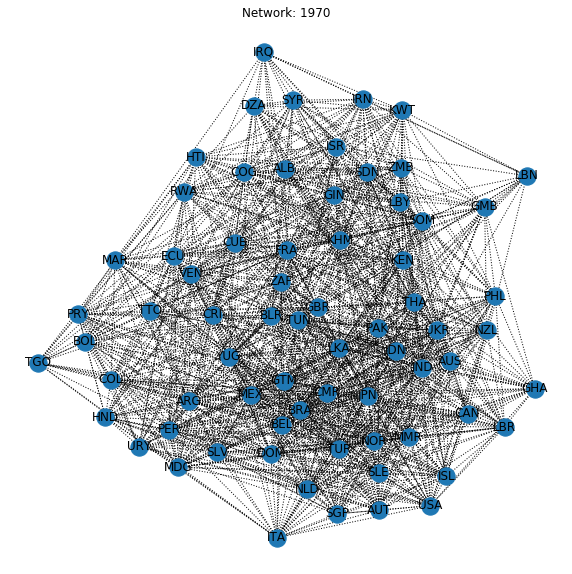

In [65]:
#Plot it
layout = nx.spring_layout(g_topic1970, k = 1/3, weight='weight', iterations= 100)

#Show the graph and save it to a local repo
fig, ax = plt.subplots(figsize = (10,10))
nx.draw(g_topic1970, ax=ax, pos = layout, labels = {n:n for n in g_topic1970.nodes()}, style='dotted', width=0.1)
plt.title('Network: 1970')
plt.savefig('./pic/Network_1970.png', format='PNG')
plt.show()

In [66]:
#Density of this graph
nx.density(g_topic1970)

0.49813664596273294

In [67]:
#diameter for this graph
nx.diameter(g_topic1970)

3

In [68]:
#Average shortest path length for this graph
nx.average_shortest_path_length(g_topic1970)

1.5026915113871635

In [81]:
#If we try to color those nodes that belongs to NATO
nato = ['USA', 'CAN', 'BEL', 'FRA', 'LUX', 'NLD', 'GBR', 'DNK', 'ISL', 'PRT', 'GRC', 'TUR', 'DEU', 'ESP']
wto = ['RUS', 'ALB', 'BGR', 'CSK', 'DDR', 'HUN', 'POL', 'ROU']
nodes_nato_1970 = [n for n in g_topic1970.nodes if n in nato]
nodes_wto_1970 = [n for n in g_topic1970.nodes if n in wto]
nodes_not_1970 = [n for n in g_topic1970.nodes if (n not in nato) and (n not in wto)]

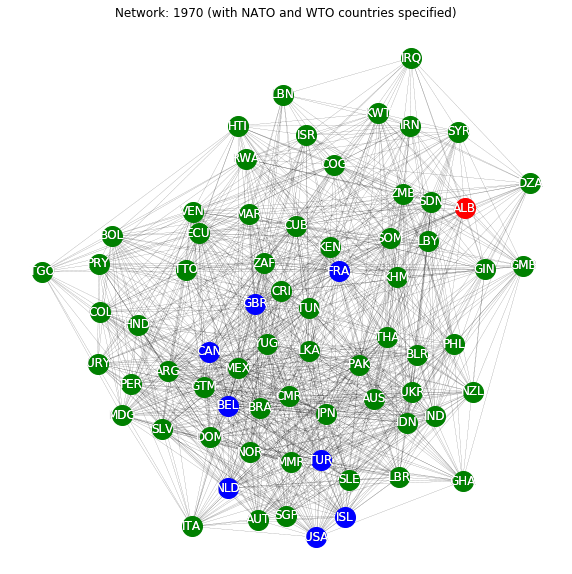

In [86]:
#Plot it
layout = nx.spring_layout(g_topic1970, weight='weight', iterations= 100)

#Show the graph and save it to a local repo
fig, ax = plt.subplots(figsize = (10,10))
nx.draw(g_topic1970, ax=ax, pos = layout, labels = {n:n for n in g_topic1970.nodes()}, node_size=400,
        nodelist=nodes_nato_1970, node_color='blue', style='dotted', width=0.1)
nx.draw(g_topic1970, ax=ax, pos = layout, labels = {n:n for n in g_topic1970.nodes()}, font_color='w', node_size=400,
        nodelist=nodes_wto_1970, node_color='red', style='dotted', width=0.1)
nx.draw(g_topic1970, ax=ax, pos = layout, labels = {n:n for n in g_topic1970.nodes()}, font_color='w', node_size=400,
        nodelist=nodes_not_1970, node_color='green', style='dotted', width=0.1)
plt.title('Network: 1970 (with NATO and WTO countries specified)')
plt.savefig('./pic/Network_1970_nato.png', format='PNG')
plt.show()

#### b. A Loop to construct all networks from 1970 to 2018

In [96]:
g_list = [] #A list to store all graphs
g_density_list = [] #A list to store the denisty of each graph
g_diameter_list = [] #A list to for diameter
g_path_list = [] #For average shortest path length

years = np.arange(1971, 2019, 1, dtype='int32')
#Add 1970 into the lists above (running another time is way too slow)
g_list.append(g_topic1970)
g_density_list.append(nx.density(g_topic1970))
g_diameter_list.append(nx.diameter(g_topic1970))
g_path_list.append(nx.average_shortest_path_length(g_topic1970))

Graph for year 1971 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


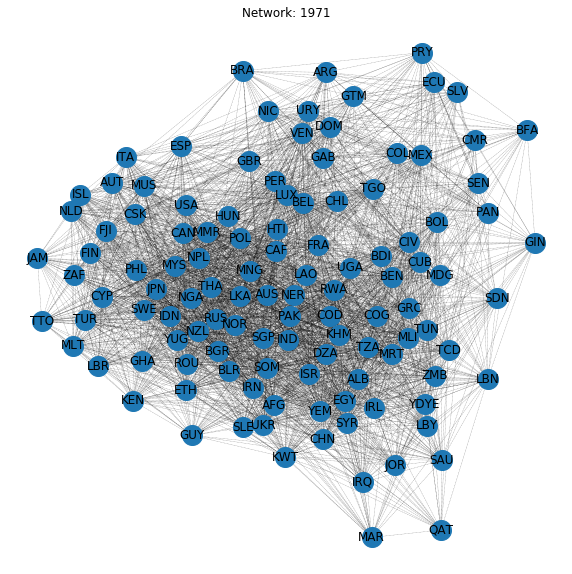

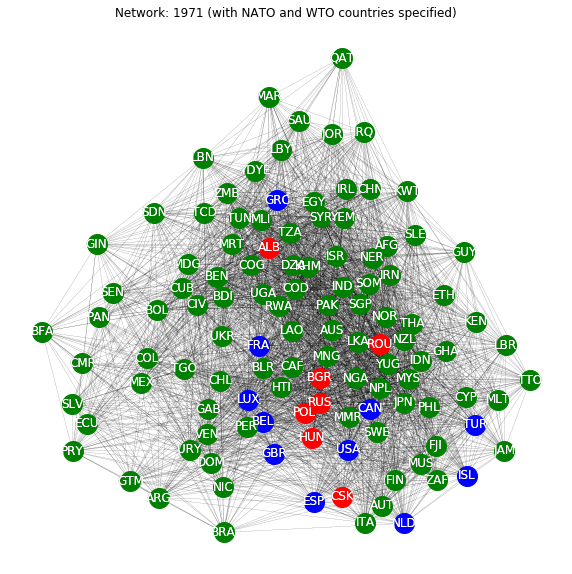

Graph for year 1972 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


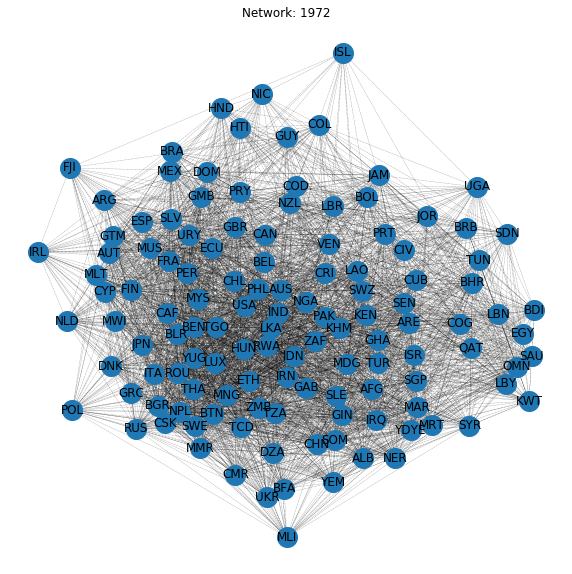

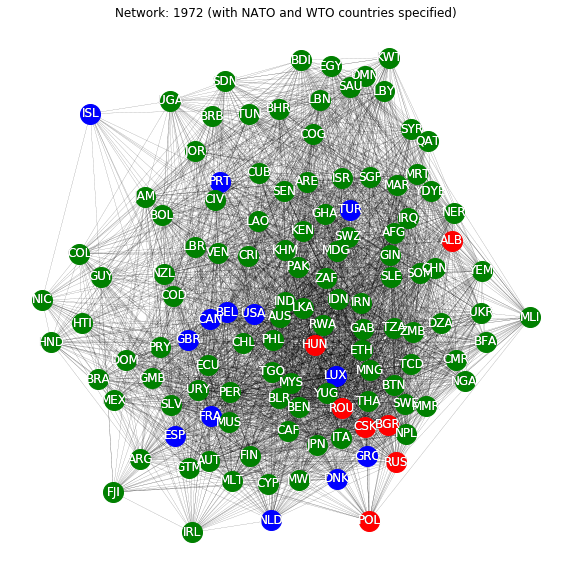

Graph for year 1973 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


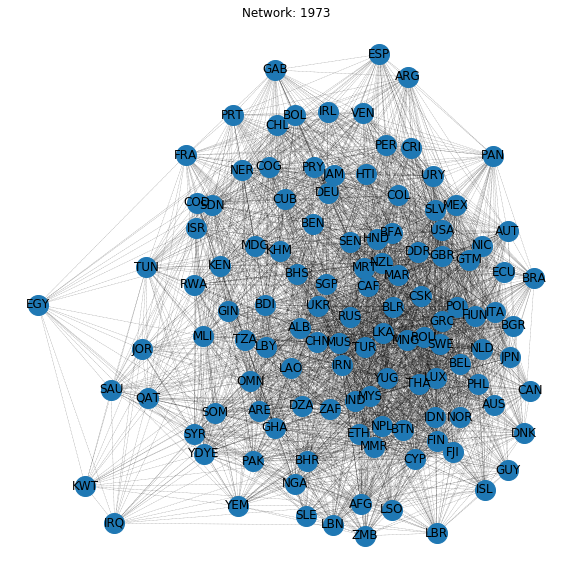

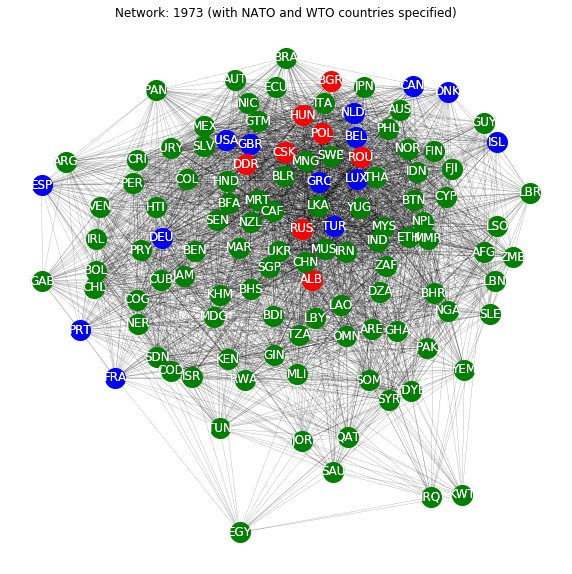

Graph for year 1974 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


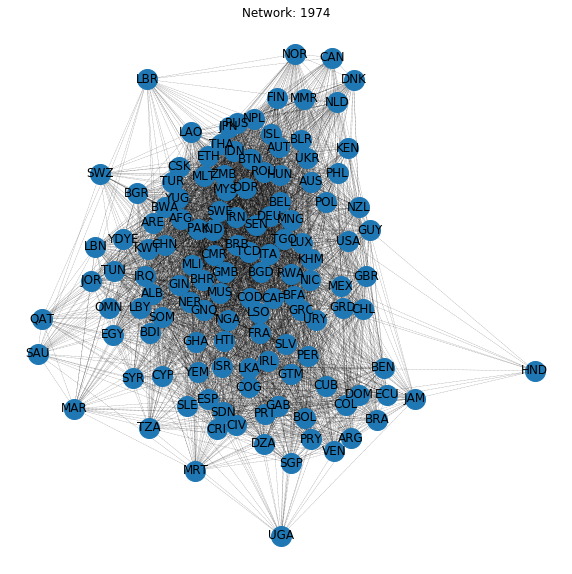

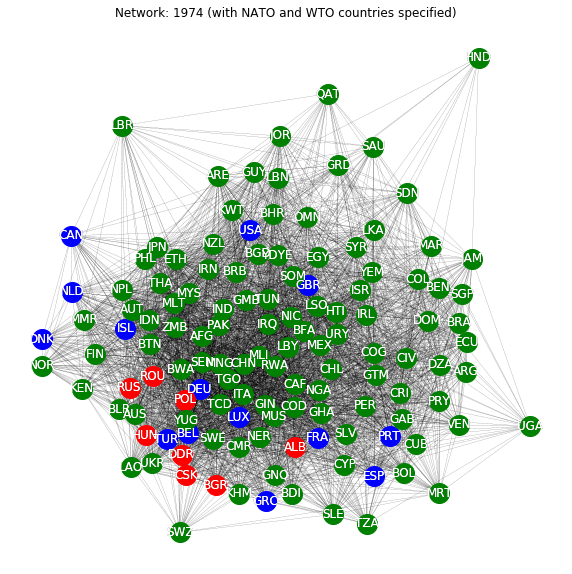

Graph for year 1975 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


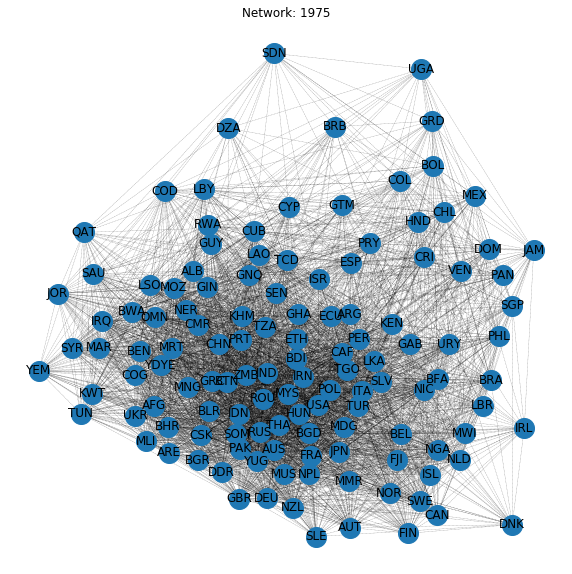

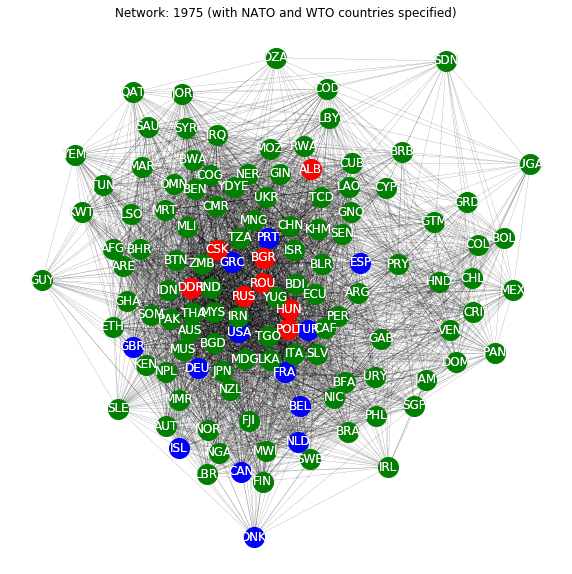

Graph for year 1976 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


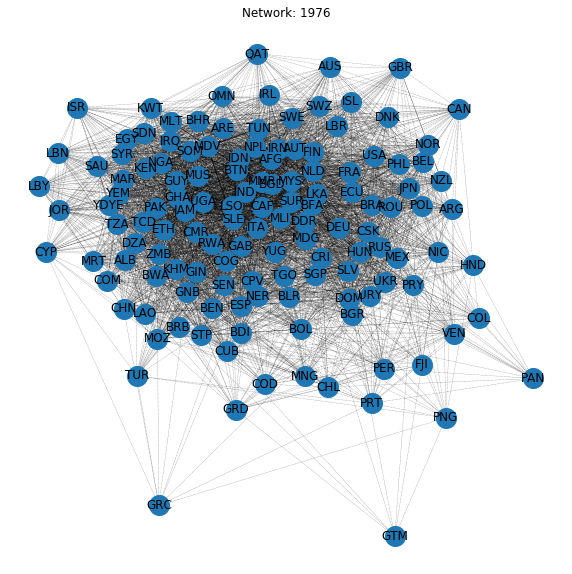

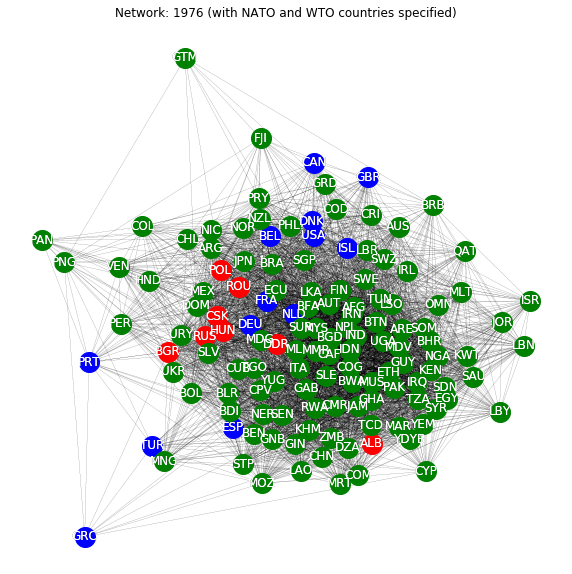

Graph for year 1977 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


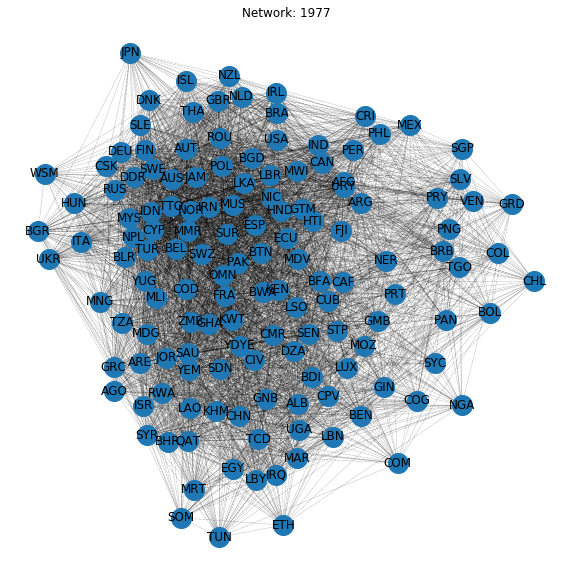

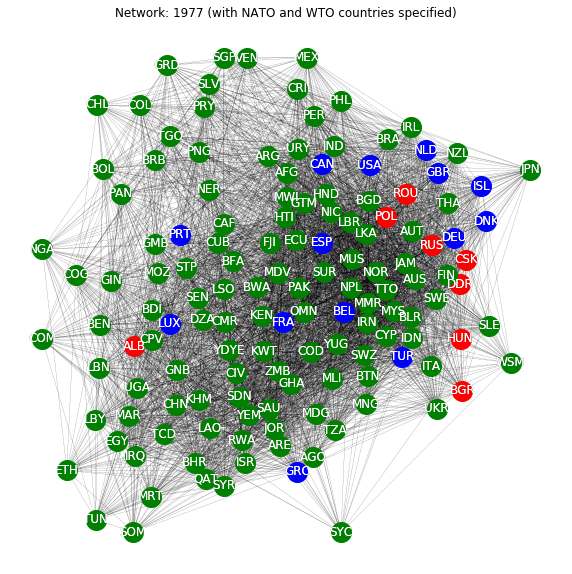

Graph for year 1978 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


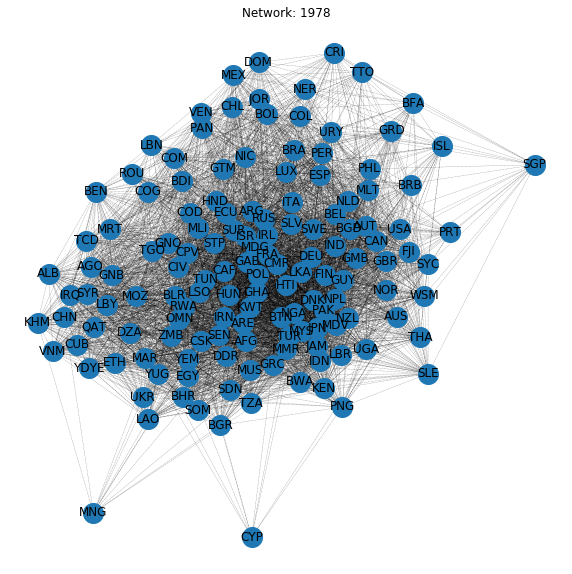

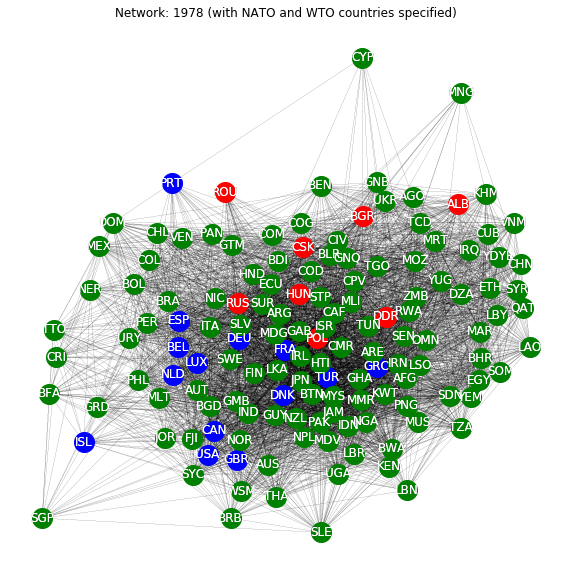

Graph for year 1979 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


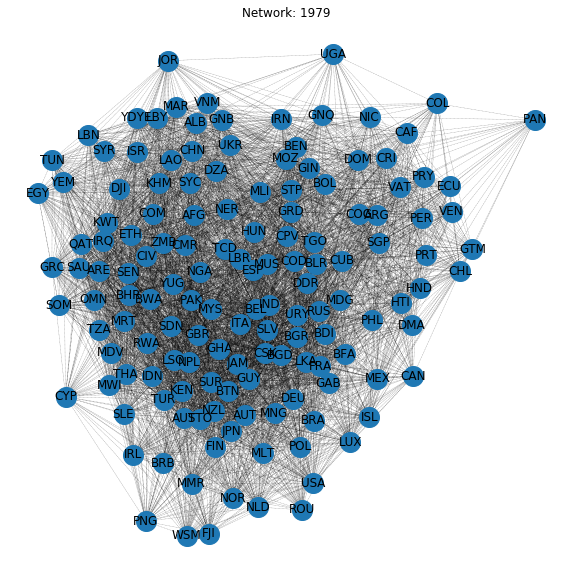

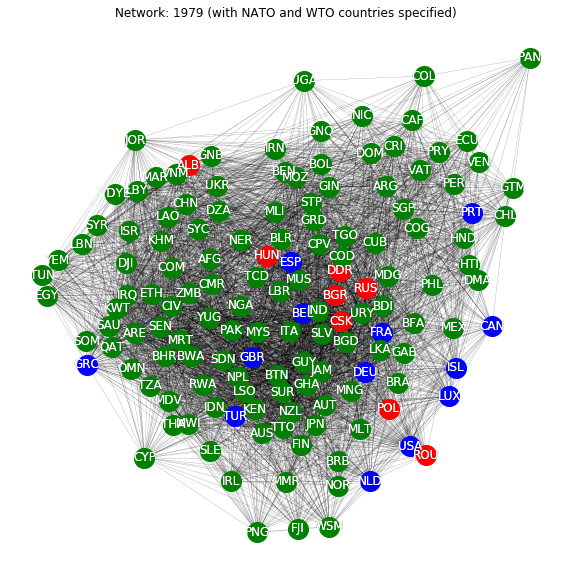

Graph for year 1980 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


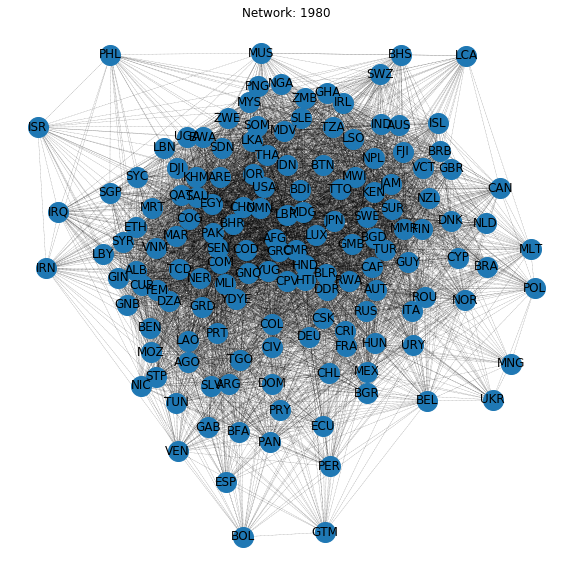

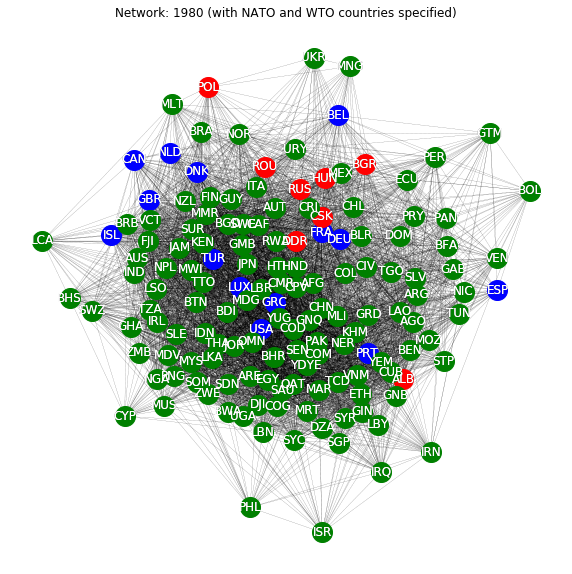

Graph for year 1981 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


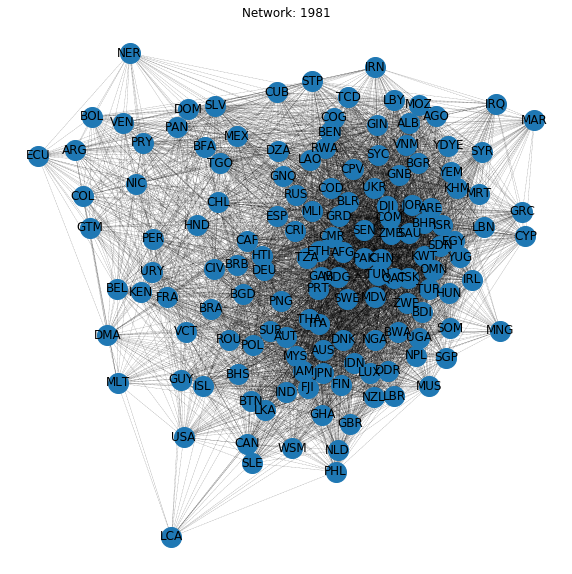

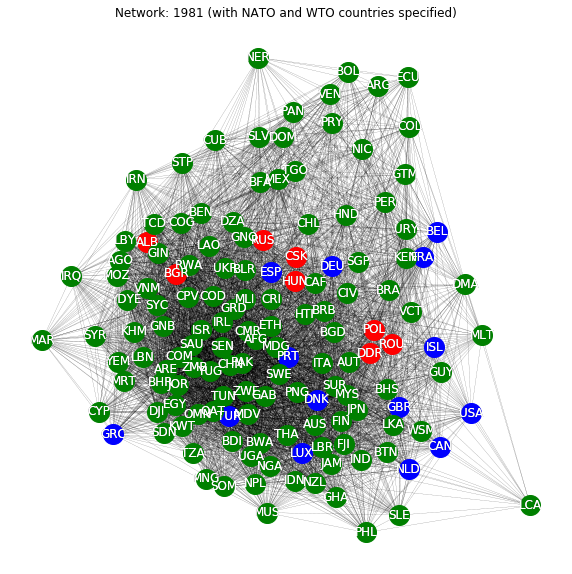

Graph for year 1982 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


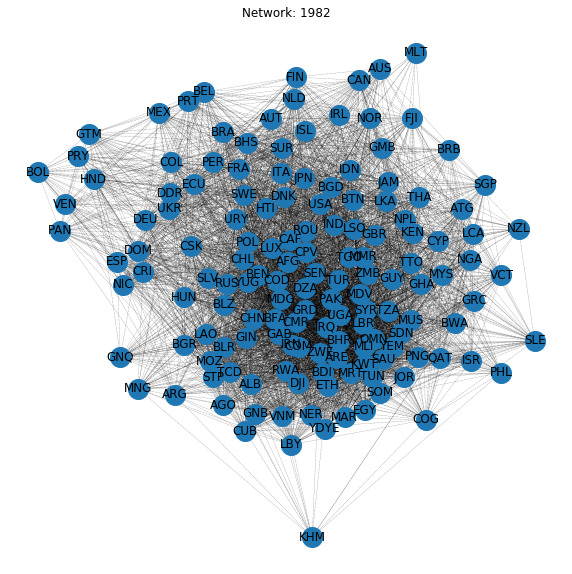

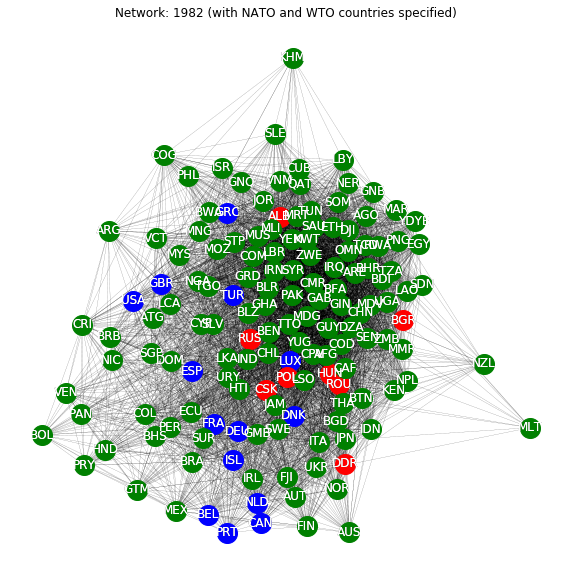

Graph for year 1983 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


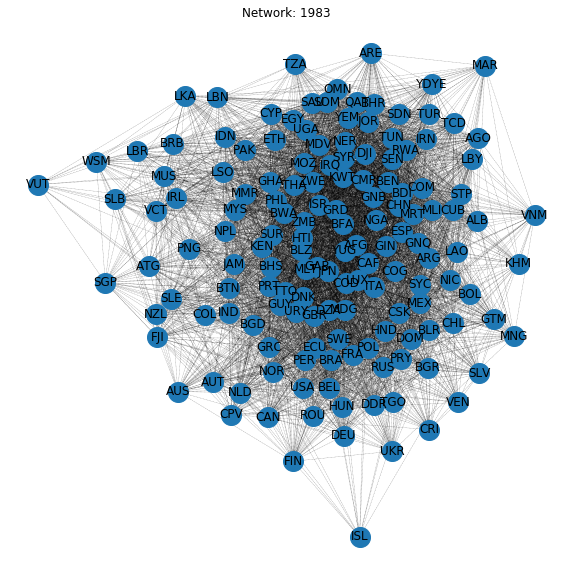

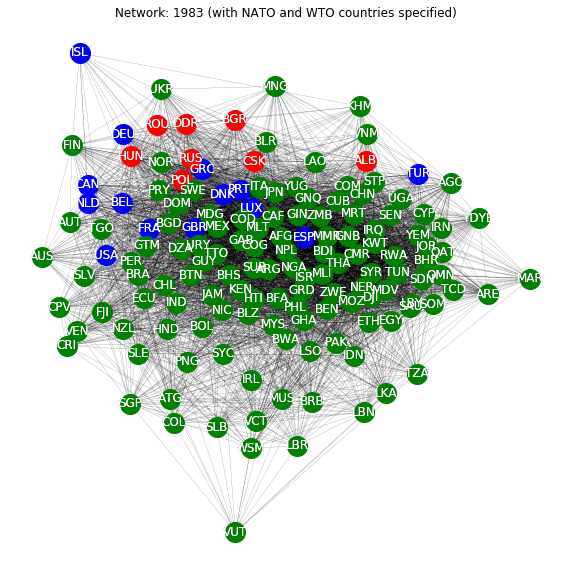

Graph for year 1984 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


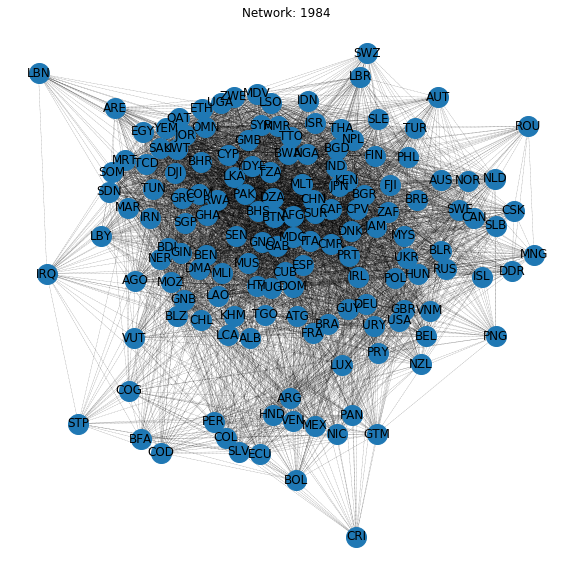

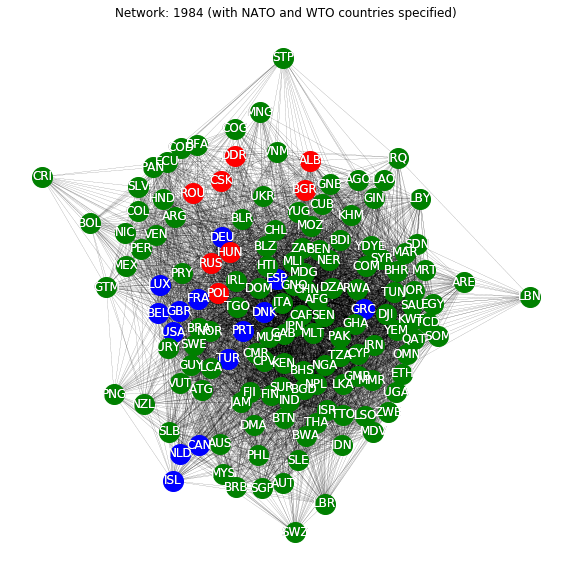

Graph for year 1985 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


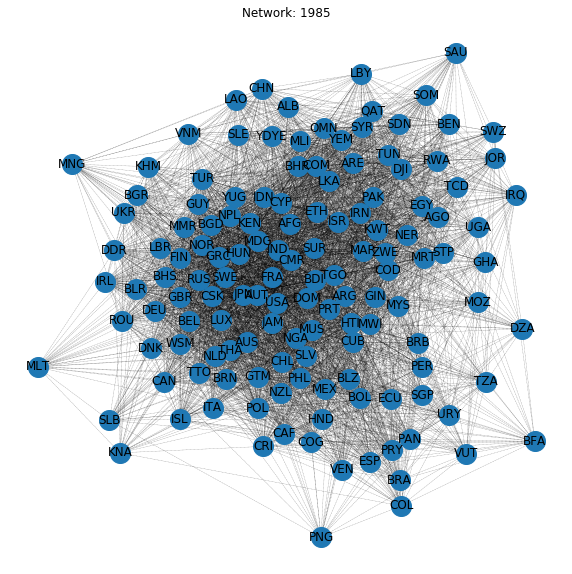

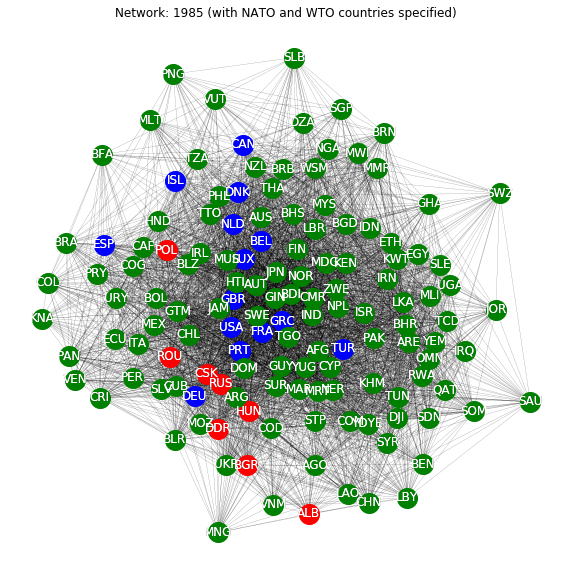

Graph for year 1986 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


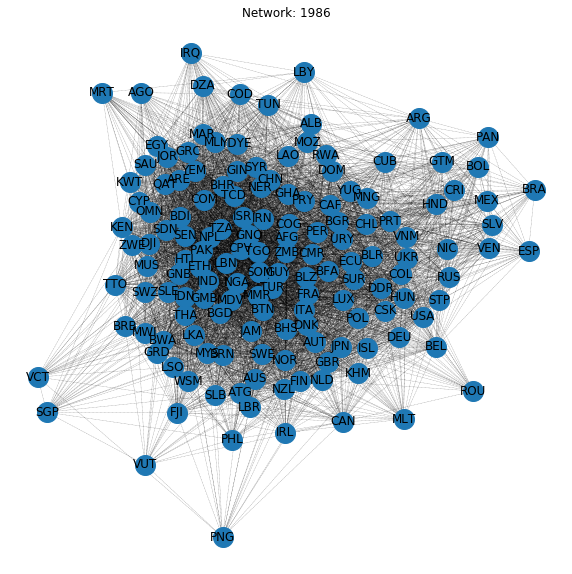

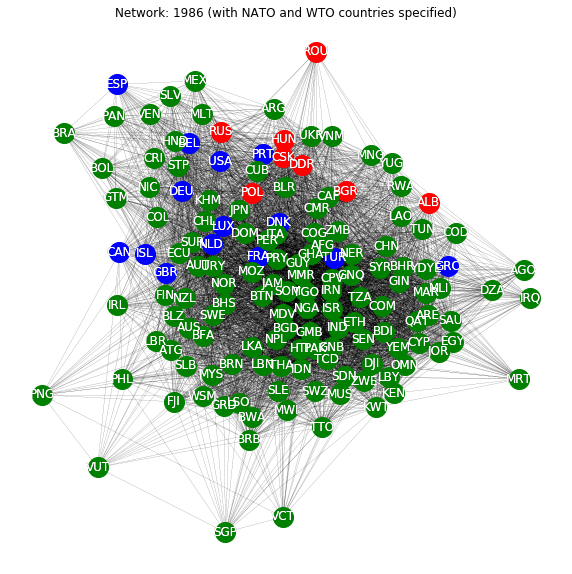

Graph for year 1987 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


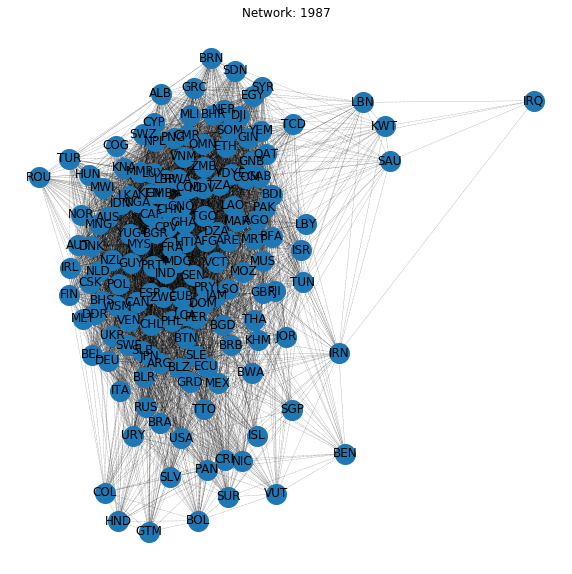

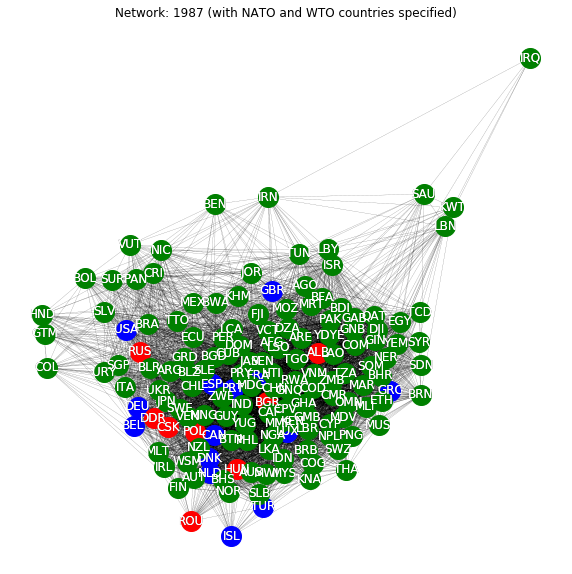

Graph for year 1988 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


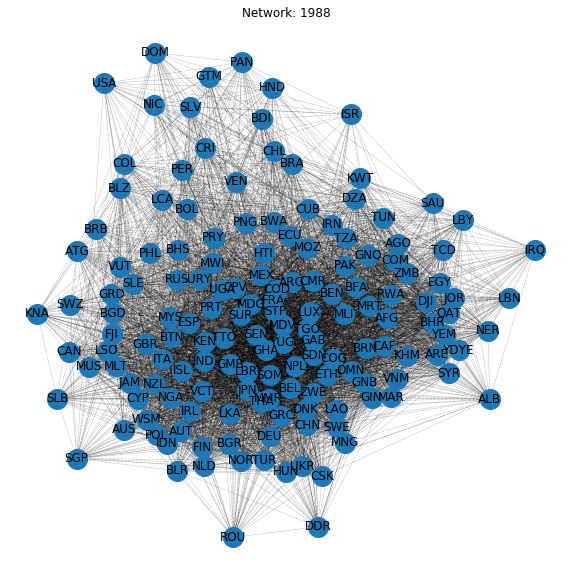

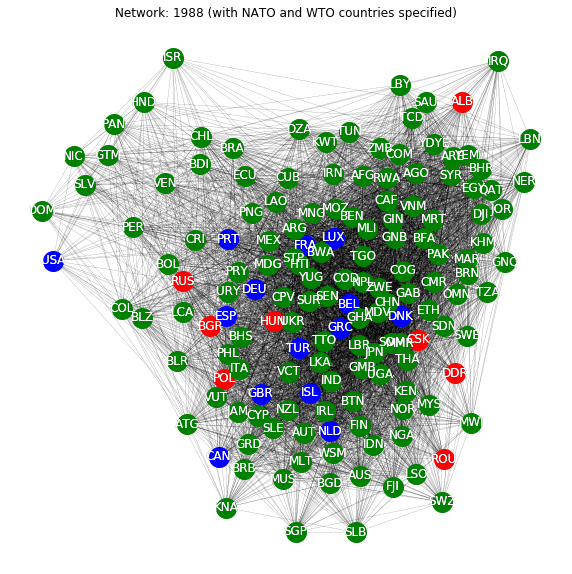

Graph for year 1989 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


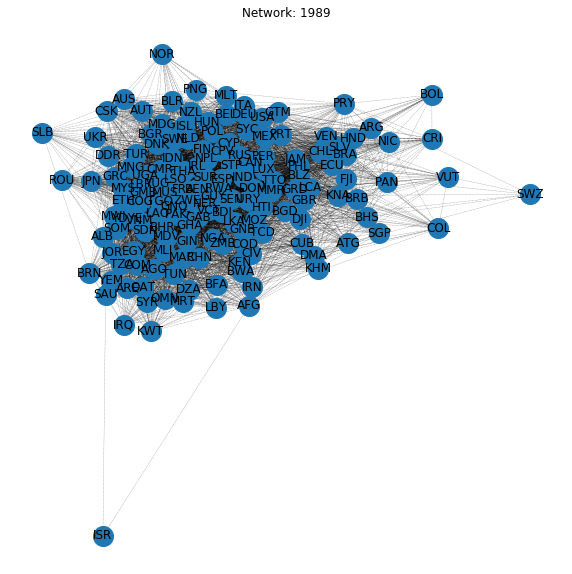

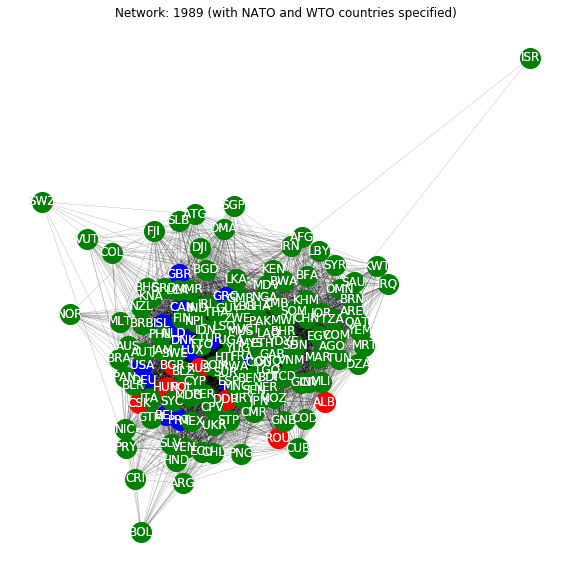

Graph for year 1990 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


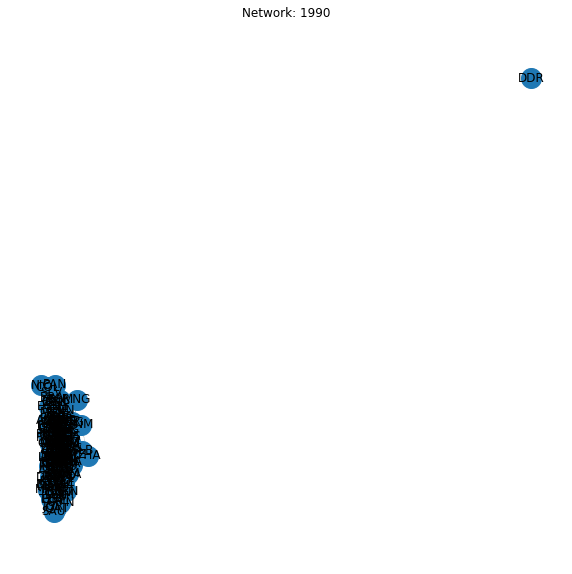

The graph is not connected at year 1990
The graph is not connected at year 1990


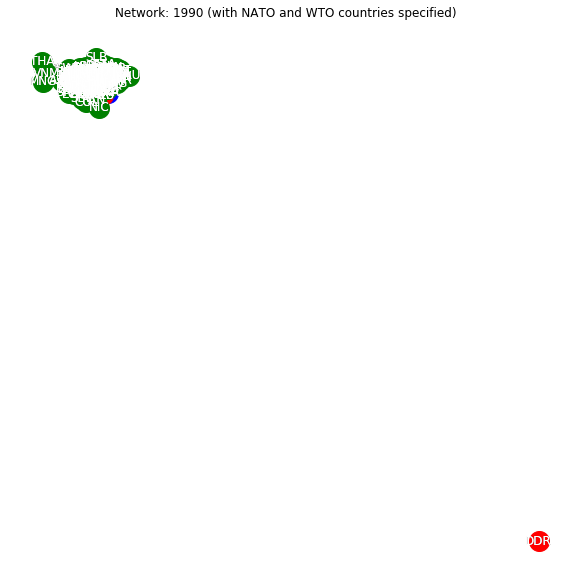

Graph for year 1991 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


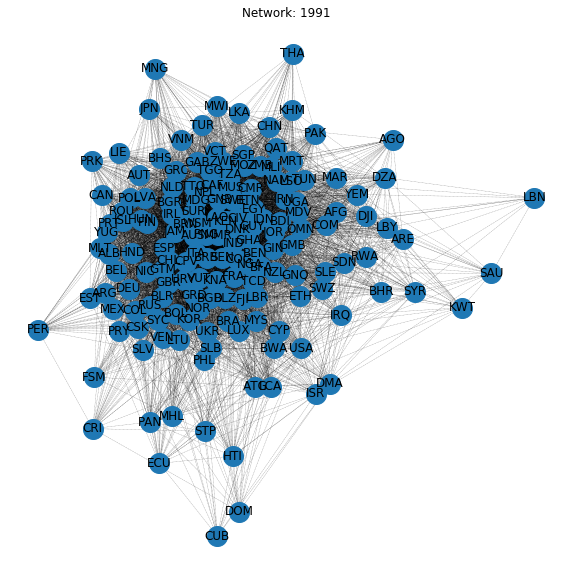

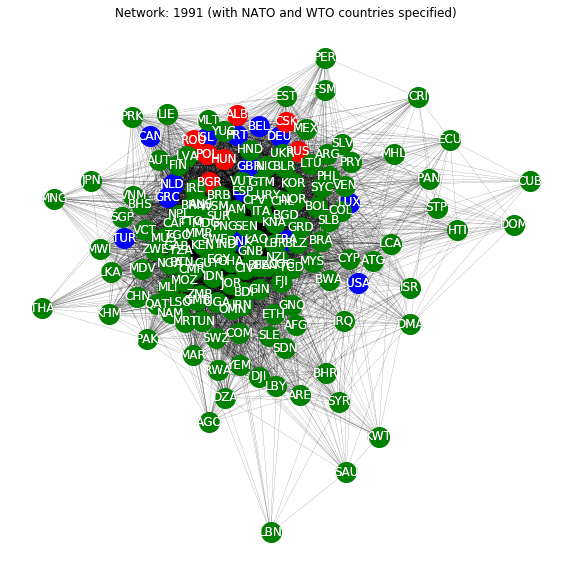

Graph for year 1992 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


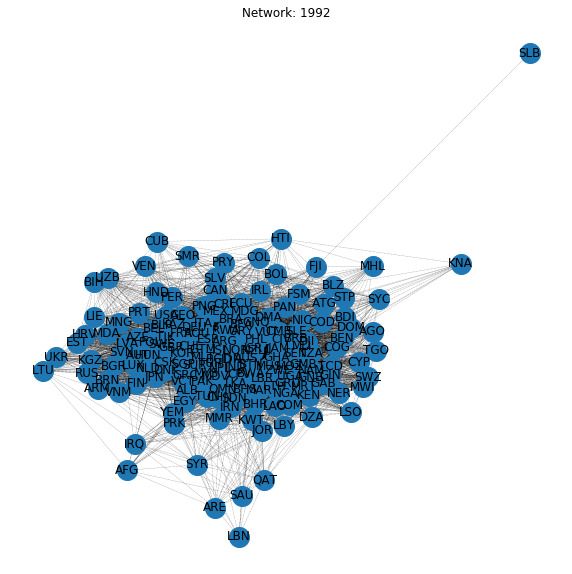

Graph for year 1993 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


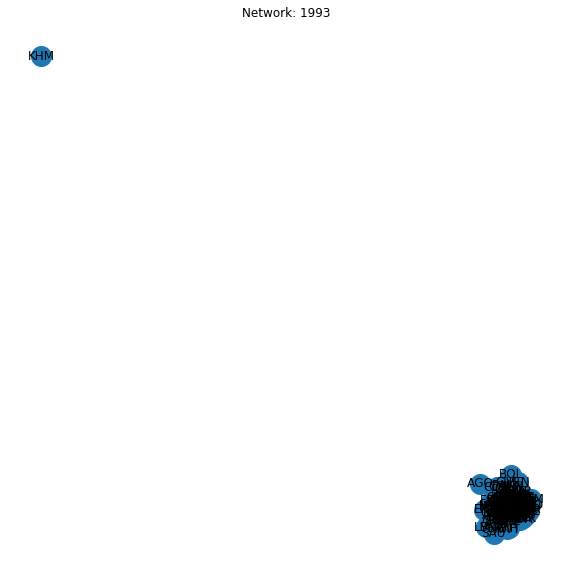

The graph is not connected at year 1993
The graph is not connected at year 1993
Graph for year 1994 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


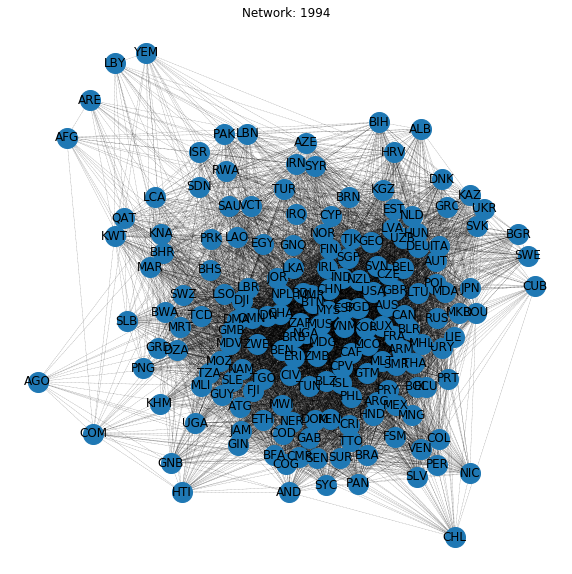

Graph for year 1995 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


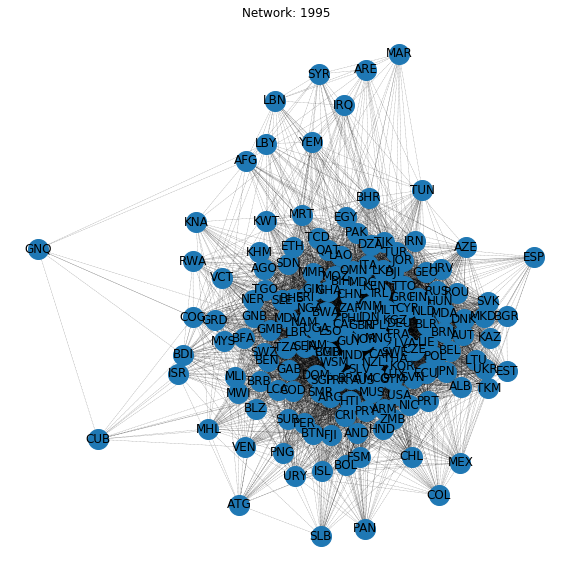

Graph for year 1996 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


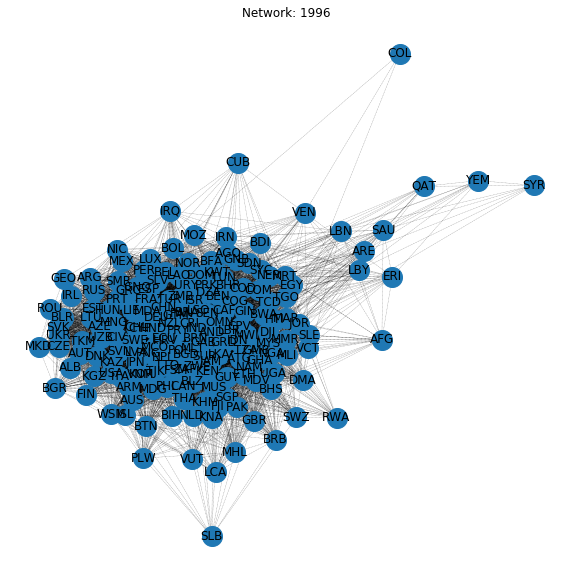

Graph for year 1997 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


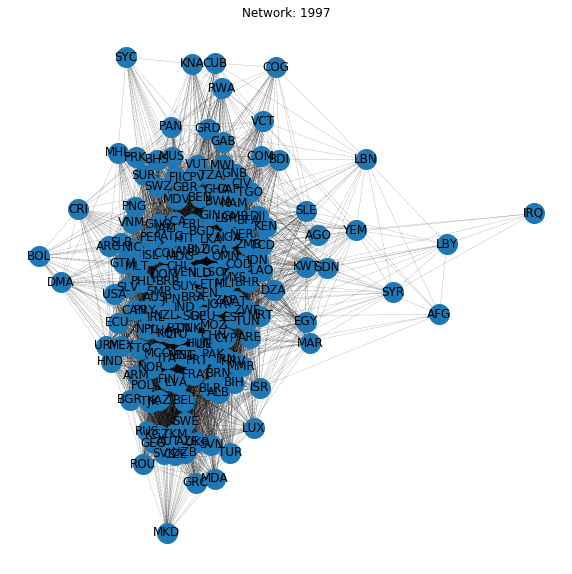

Graph for year 1998 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


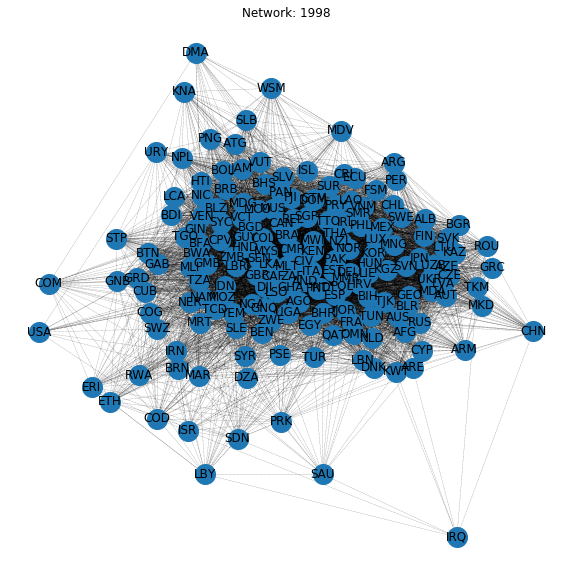

Graph for year 1999 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


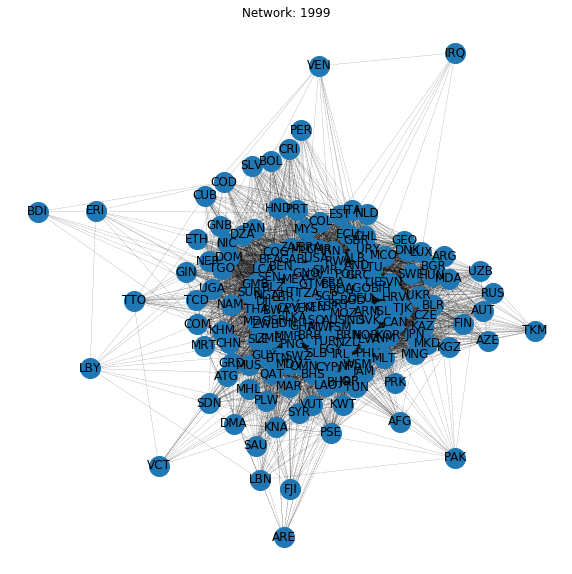

Graph for year 2000 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


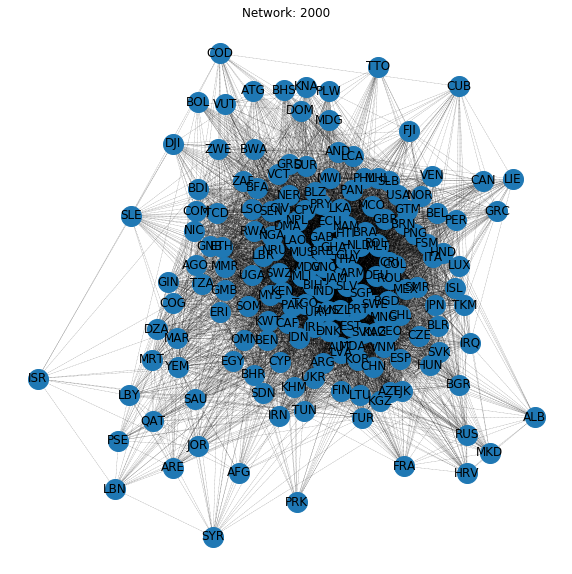

Graph for year 2001 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


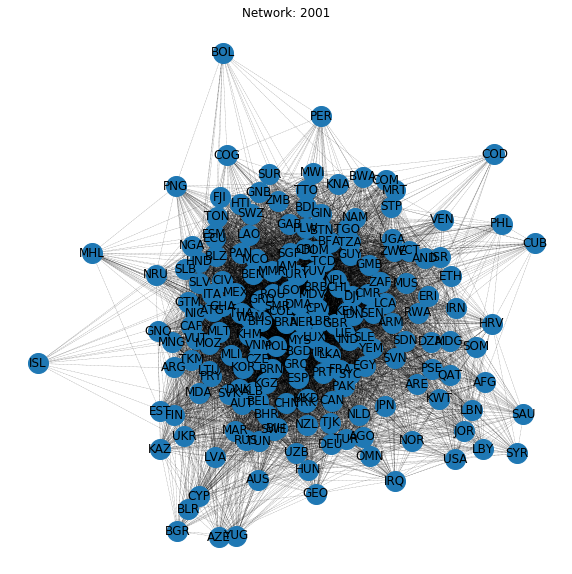

Graph for year 2002 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


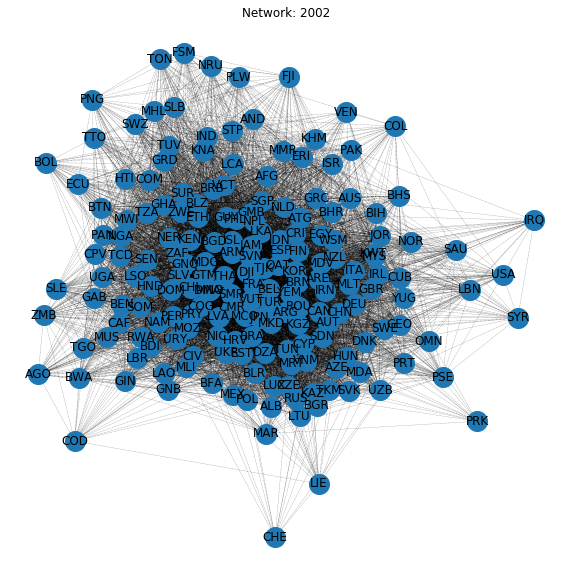

Graph for year 2003 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


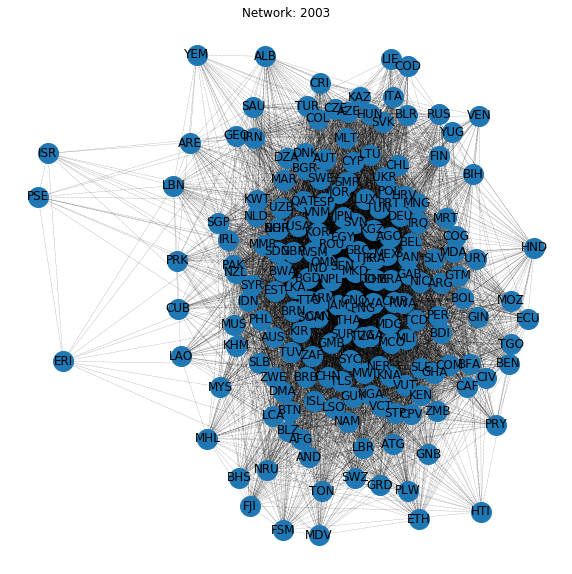

Graph for year 2004 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


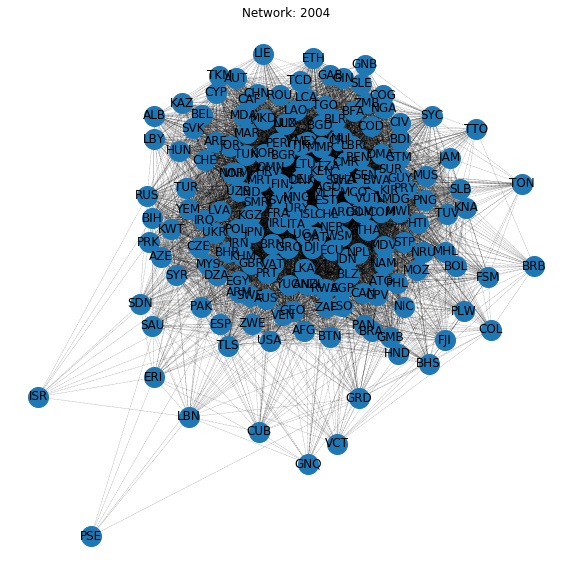

Graph for year 2005 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


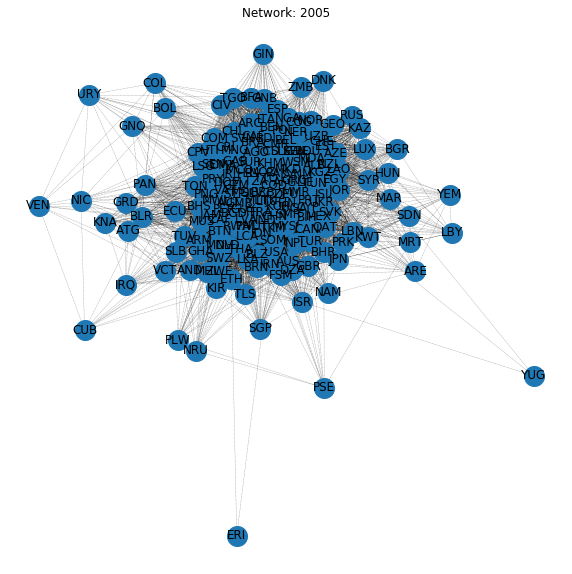

Graph for year 2006 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


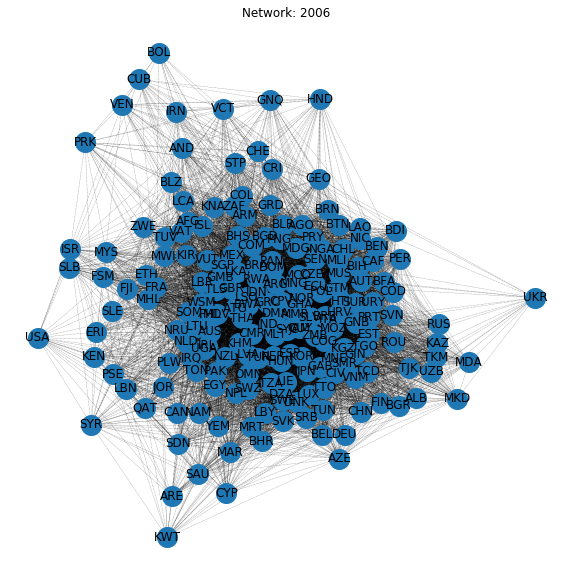

Graph for year 2007 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


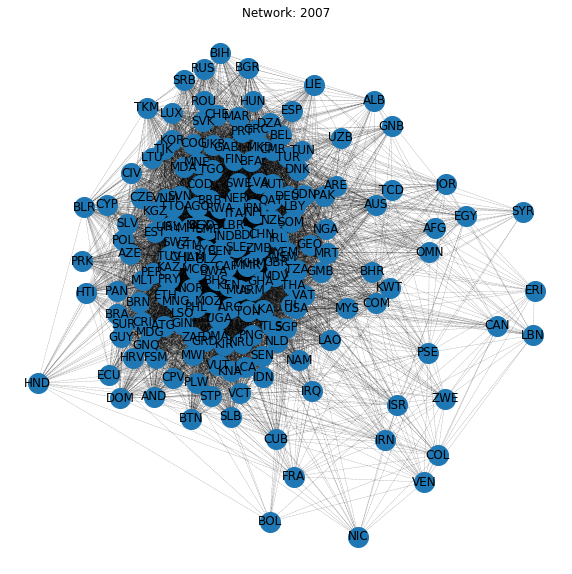

Graph for year 2008 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


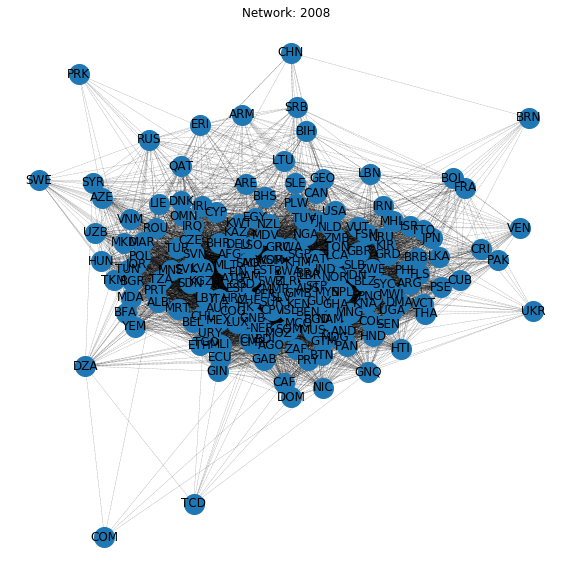

Graph for year 2009 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


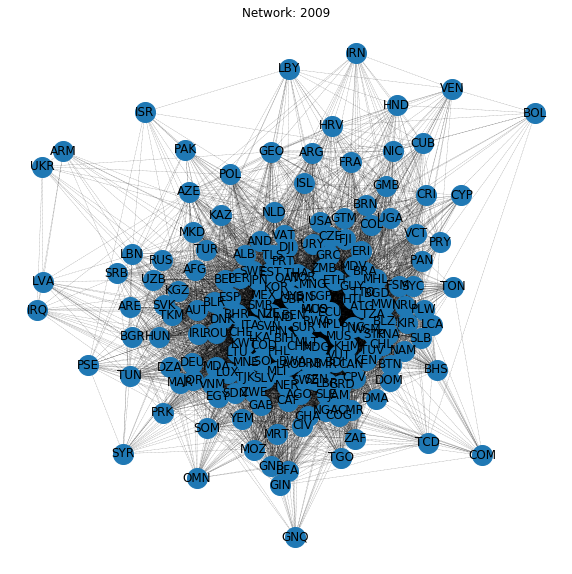

Graph for year 2010 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


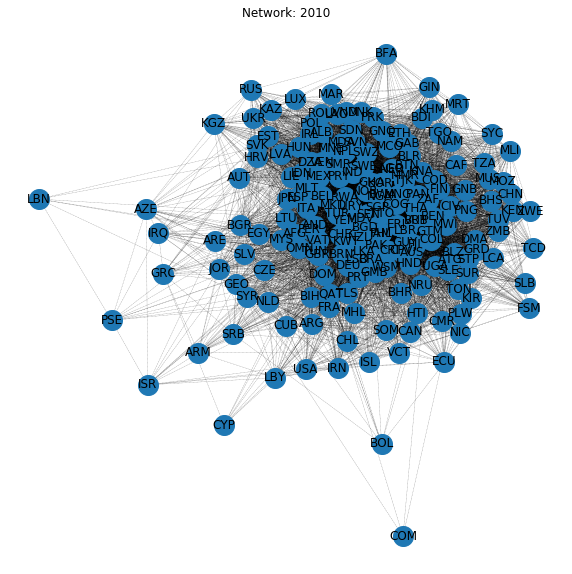

Graph for year 2011 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


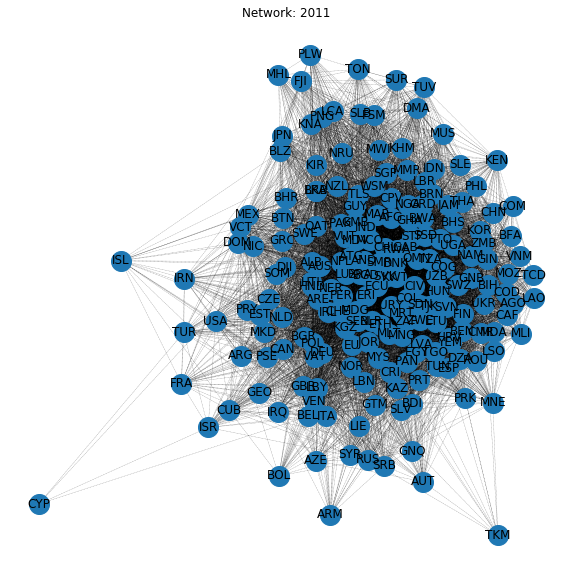

Graph for year 2012 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


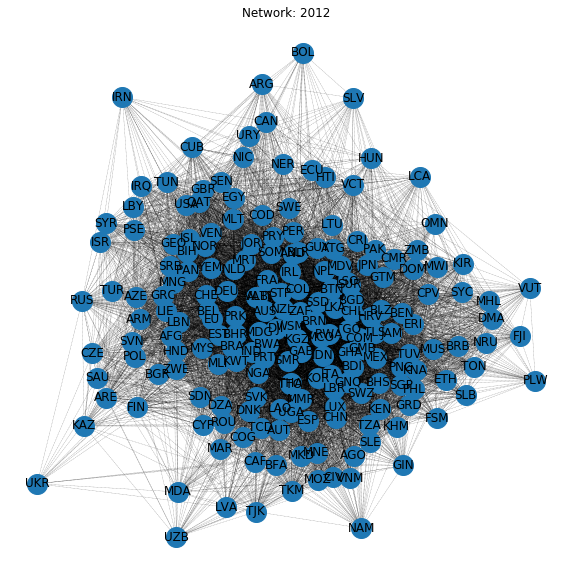

Graph for year 2013 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


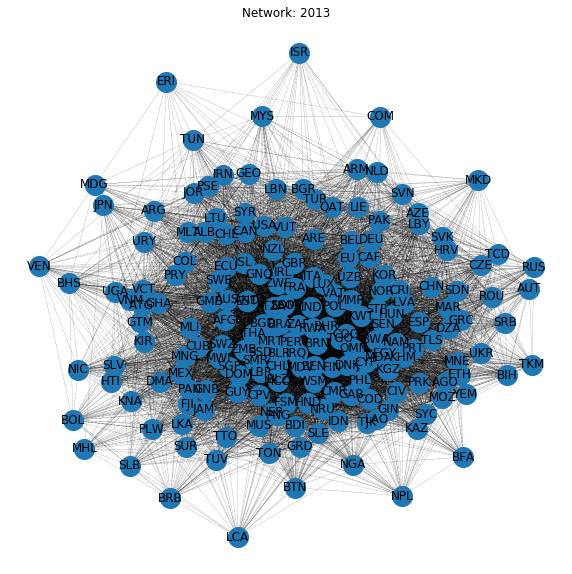

Graph for year 2014 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


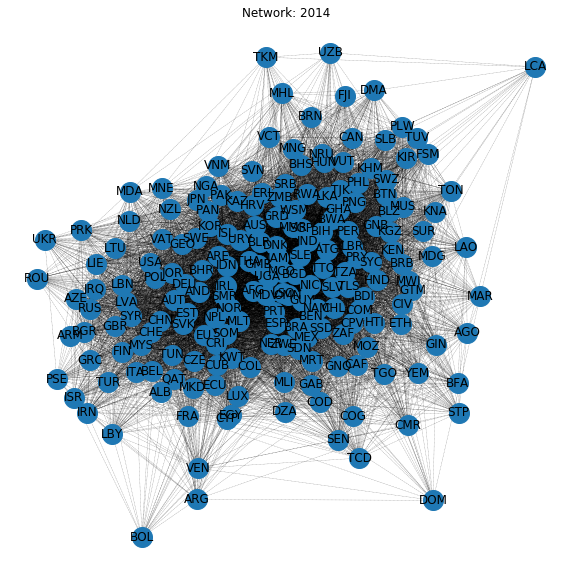

Graph for year 2015 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


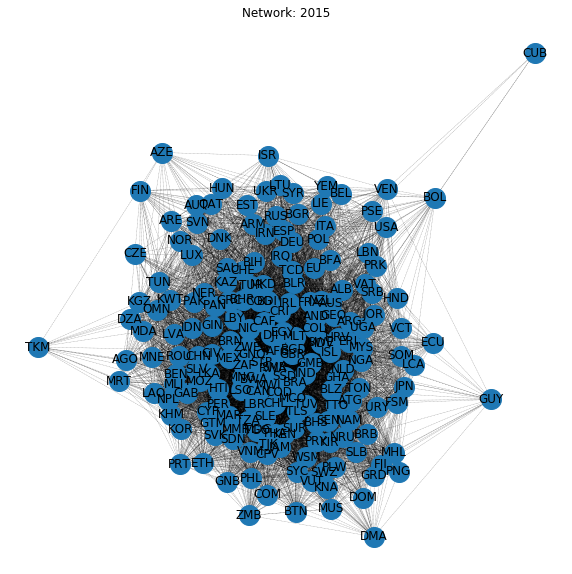

Graph for year 2016 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


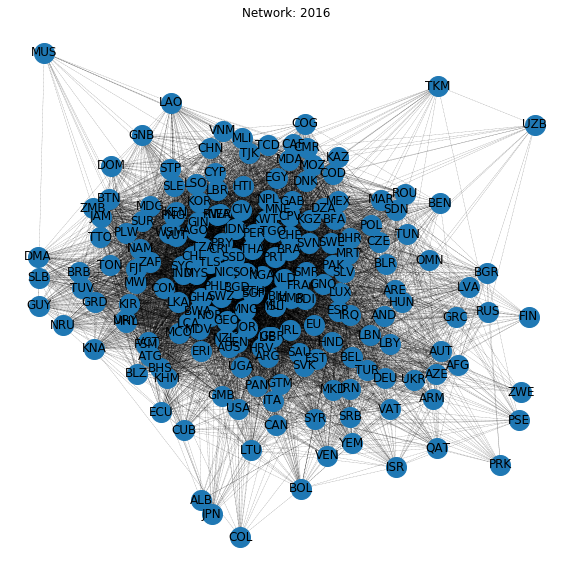

Graph for year 2017 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


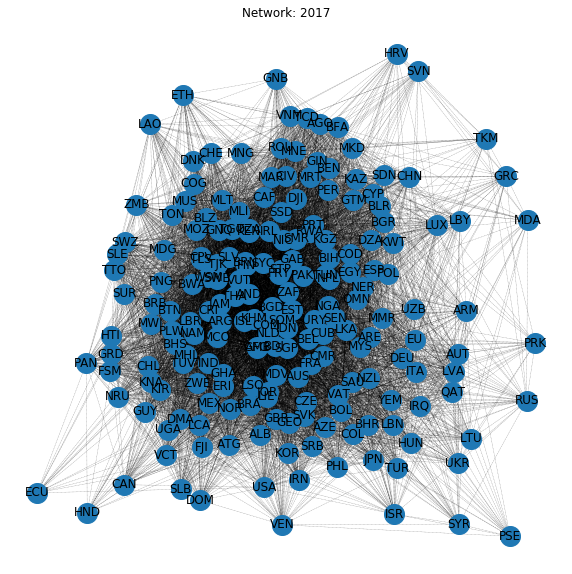

Graph for year 2018 done!


/Users/heatherchen/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


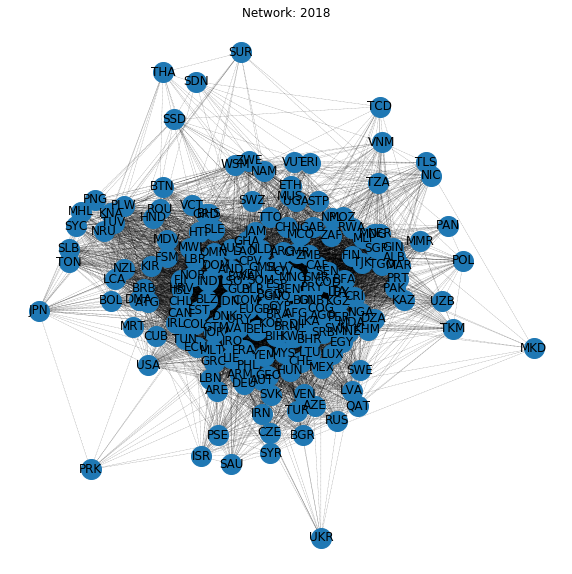

In [97]:
from networkx import NetworkXError
#Start the loop
for year in years:
    ungdc_temp_df = ungdc_df.loc[ungdc_df['year']==str(year)]
    unlda_temp_df = pd.DataFrame({
        'filename' : ungdc_temp_df['filename'],
        'country' : ungdc_temp_df['country_code'],
        'topics' : [unlda_opt[dict_opt.doc2bow(l)] for l in ungdc_temp_df['reduced_tokens']]
    })
    
    topics_prob_dict = {i : [0] * len(unlda_temp_df) for i in range(unlda_opt.num_topics)}
    
    for index, topic_tuples in enumerate(unlda_temp_df['topics']):
        for topic_num, prob in topic_tuples:
            topics_prob_dict[topic_num][index] = prob

    for topic_num in range(unlda_opt.num_topics):
        unlda_temp_df['topic_{}'.format(topic_num)] = topics_prob_dict[topic_num]
        
    g_topic_temp = nx.Graph()
    g_topic_temp.add_nodes_from(unlda_temp_df['country'])
    
    for con1 in unlda_temp_df['country']:
        for con2 in unlda_temp_df['country']:
            if (con1 != con2) & (g_topic_temp.has_edge(con1, con2) == False):
                con1_score = []
                con2_score = []
                for topic_num in range(unlda_opt.num_topics):
                    con1_score.append(unlda_temp_df.loc[unlda_temp_df['country']==con1, 'topic_{}'.format(topic_num)].values[0])
                    con2_score.append(unlda_temp_df.loc[unlda_temp_df['country']==con2, 'topic_{}'.format(topic_num)].values[0])
                w = sklearn.metrics.normalized_mutual_info_score(con1_score, con2_score)
                g_topic_temp.add_edge(con1, con2, weight=w)
    print('Graph for year', str(year), 'done!')
    
    w_median_temp = np.median([d['weight'] for n1, n2, d in g_topic_temp.edges(data = True)])
    
    #Draw and save the graph
    g_topic_temp.remove_edges_from([(n1, n2) for n1, n2, d in g_topic_temp.edges(data = True) if d['weight'] <= w_median_temp])
    layout = nx.spring_layout(g_topic_temp, weight='weight', iterations= 100)

    fig, ax = plt.subplots(figsize = (10,10))
    nx.draw(g_topic_temp, ax=ax, pos = layout, labels = {n:n for n in g_topic_temp.nodes()}, 
            node_size=400, style='dotted', width=0.3)
    plt.title('Network: '+str(year))
    plt.savefig('./pic/Network_'+str(year)+'.png', format='PNG')
    plt.show()
    
    #Save information about this graph to the list
    g_list.append(g_topic_temp)
    g_density_list.append(nx.density(g_topic_temp))
    #We set the number of diameter and average_shortest_path_length equal to -1 for years whose networks are not connected
    try:
        g_diameter_list.append(nx.diameter(g_topic_temp))
    except NetworkXError:
        print("The graph is not connected at year", str(year))
        g_diameter_list.append(-1)
    try:
        g_path_list.append(nx.average_shortest_path_length(g_topic_temp))
    except NetworkXError:
        print("The graph is not connected at year", str(year))
        g_path_list.append(-1)
    
    #Color the nato nodes
    nodes_nato_temp = [n for n in g_topic_temp.nodes if n in nato]
    nodes_wto_temp = [n for n in g_topic_temp.nodes if n in wto]
    nodes_not_temp = [n for n in g_topic_temp.nodes if (n not in nato) and (n not in wto)]
    
    #Plot it and save
    if year<=1991:
        layout = nx.spring_layout(g_topic_temp, weight='weight', iterations= 100)

        fig, ax = plt.subplots(figsize = (10,10))
        nx.draw(g_topic_temp, ax=ax, pos = layout, labels = {n:n for n in g_topic_temp.nodes()}, node_size=400,nodelist=nodes_nato_temp, node_color='blue', style='dotted', width=0.1)
        nx.draw(g_topic_temp, ax=ax, pos = layout, labels = {n:n for n in g_topic_temp.nodes()}, font_color='w', node_size=400,nodelist=nodes_wto_temp, node_color='red', style='dotted', width=0.1)
        nx.draw(g_topic_temp, ax=ax, pos = layout, labels = {n:n for n in g_topic_temp.nodes()}, font_color='w', node_size=400,nodelist=nodes_not_temp, node_color='green', style='dotted', width=0.1)
        plt.title('Network: '+str(year)+' (with NATO and WTO countries specified)')
        plt.savefig('./pic/Network_'+str(year)+'_nato.png', format='PNG')
        plt.show()
    

Text(0.5, 1.0, 'Graph density for all years')

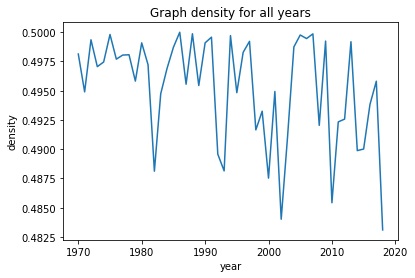

In [98]:
#Plot the density for each network
import seaborn as sns

years = np.arange(1970, 2019, 1, dtype='int32')
g_stat_df = pd.DataFrame(list(zip(list(years), g_density_list)), columns=['year', 'density'])
sns.lineplot(x='year', y='density', data=g_stat_df)
plt.title('Graph density for all years')

In [100]:
g_diameter_list = np.array(g_diameter_list)
g_path_list = np.array(g_path_list)

In [101]:
#Set the maximum display number of rows in pandas
pd.set_option('display.max_rows', 60)

In [102]:
#Present the basic network statistics (NAN as -1)
g_stat_df['average_path_length'] = g_path_list
g_stat_df['diameter'] = g_diameter_list
g_stat_df

,year,density,average_path_length,diameter
0,1970,0.498137,1.502692,3
1,1971,0.494903,1.505097,2
2,1972,0.499355,1.500645,2
3,1973,0.497059,1.504762,3
4,1974,0.497456,1.503634,3
5,1975,0.499810,1.500317,3
6,1976,0.497699,1.504994,3
7,1977,0.498047,1.502055,3
8,1978,0.498075,1.504154,3
9,1979,0.495824,1.505148,3


In [173]:
#Mean density
np.mean(g_stat_df['density'])

0.49518696706395937

In [174]:
#Standard deviation of density
np.std(g_stat_df['density'])

0.00455922701776612

In [202]:
#Mean of average shortest path length
np.mean(g_stat_df.loc[g_stat_df['average_path_length']!=-1]['average_path_length'])

1.50832878290052

In [203]:
#Mean of diameter
np.mean(g_stat_df.loc[g_stat_df['diameter']!=-1]['diameter'])

2.9361702127659575

In [131]:
#Save those networks to gml file
for year in range(len(g_list)):
    nx.write_gml(g_list[year], './networks/graph_'+str(year+1970)+'.gml')

#### c. Important statistics in Network analysis

i. Degree centrality

In [103]:
#Select our country of interest
countries_int = ['USA', 'CHN', 'GBR', 'FRA', 'JPN', 'RUS', 'IRQ', 'IRN', 'PAK']

In [104]:
#Calculate degree centralities for each graph
dcentrality_list = []
country_dcen_df = pd.DataFrame(countries_int, columns = ['country'])
dcen_df = pd.DataFrame(columns=['year', 'Top 10 countries', 'Last 10 countries'])

for num_year in range(len(g_list)):
    dict_cen = {}
    dict_cen['year'] = 1970 + num_year
    
    d_cen = nx.degree_centrality(g_list[num_year])
    
    #Get the top 10 and last 10 countries by degree centrality
    sorted_dcen = {k: v for k, v in sorted(d_cen.items(), key=lambda item: item[1], reverse=True)}
    dict_cen['Top 10 countries'] = list(sorted_dcen.keys())[:10]
    dict_cen['Last 10 countries'] = list(sorted_dcen.keys())[-10:]
    #print(1970+num_year, dict_cen)
    dcen_df = dcen_df.append(dict_cen, ignore_index=True)  

In [105]:
#Present the top 10 and last 10 countries by degree centrality in a dataframe
dcen_df

,year,Top 10 countries,Last 10 countries
0,1970,"[GBR, LKA, MEX, BEL, BRA, JPN, CMR, PAK, ZAF, ...","[HND, URY, HTI, GHA, MAR, SYR, DZA, TGO, IRQ, ..."
1,1971,"[AUS, FRA, LKA, IND, DZA, NOR, NZL, PAK, LUX, ...","[ECU, GIN, PAN, SLV, PRY, BRA, MAR, CMR, BFA, ..."
2,1972,"[LKA, IND, IRN, HUN, ETH, KHM, LUX, RWA, PAK, ...","[HTI, KWT, UGA, HND, IRL, GUY, NIC, QAT, FJI, ..."
3,1973,"[CAF, IRN, MUS, MYS, MRT, IND, RUS, THA, LKA, ...","[FRA, LBR, YEM, GUY, JOR, SLE, SAU, IRQ, KWT, ..."
4,1974,"[NIC, RWA, PAK, BFA, COD, MLI, ITA, CAF, IND, ...","[CAN, TZA, KEN, MAR, SWZ, LBR, QAT, SAU, UGA, ..."
5,1975,"[MYS, IND, USA, IRN, CAF, POL, SLV, AUS, BGD, ...","[GUY, QAT, IRL, JAM, GRD, BRB, DNK, SDN, UGA, ..."
6,1976,"[IND, BTN, LKA, MYS, IRN, MMR, BGD, SUR, ITA, ...","[COL, MNG, GRD, PRT, FJI, TUR, PNG, PAN, GRC, ..."
7,1977,"[FRA, PAK, OMN, HTI, SUR, ECU, NOR, BWA, GHA, ...","[SGP, TUN, ETH, VEN, NGA, SOM, COM, WSM, CHL, ..."
8,1978,"[POL, FRA, LKA, IRL, ARE, SWE, ECU, TUR, CAF, ...","[JOR, ISL, LBN, BFA, ROU, TTO, PRT, SGP, MNG, ..."
9,1979,"[IND, BEL, PAK, BGD, GBR, SLV, NER, TGO, MYS, ...","[ISR, PNG, ROU, GTM, CAN, FJI, BRB, COL, UGA, ..."


In [175]:
dcen_df.to_csv('./pic/country_in_network.csv')

In [115]:
#Now we turn to see the degree centralities for certain countries of interest across all years. Save them to a dataframe for future usage.
dict_con_list=[]

for country in countries_int:
    dict_temp = {}
    dict_temp['country'] = country
    for num_year in range(len(g_list)):
        d_cen = nx.degree_centrality(g_list[num_year])
        if country in g_list[num_year].nodes():
            dict_temp[num_year+1970] = d_cen[country]
        else:
            dict_temp[num_year+1970] = np.nan
    #print(dict_temp)
    dict_con_list.append(dict_temp)

con_dcen_df = pd.DataFrame(dict_con_list)

In [116]:
con_dcen_df

,country,1970,1971,1972,1973,1974,1975,1976,1977,1978,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,USA,0.478261,0.617391,0.612903,0.605042,0.515625,0.760,0.496241,0.561151,0.521429,...,0.578125,0.212766,0.305699,0.458763,0.531250,0.481865,0.291667,0.455959,0.400000,0.353846
1,CHN,NaN,0.452174,0.596774,0.638655,0.570312,0.608,0.413534,0.474820,0.364286,...,0.703125,0.340426,0.331606,0.618557,0.473958,0.569948,0.489583,0.398964,0.317949,0.517949
2,GBR,0.782609,0.452174,0.524194,0.613445,0.484375,0.560,0.285714,0.503597,0.514286,...,0.770833,0.585106,0.492228,0.458763,0.713542,0.383420,0.807292,0.725389,0.579487,0.728205
3,FRA,0.637681,0.756522,0.540323,0.319328,0.617188,0.528,0.593985,0.812950,0.785714,...,0.302083,0.446809,0.191710,0.680412,0.802083,0.398964,0.703125,0.813472,0.717949,0.661538
4,JPN,0.695652,0.626087,0.540323,0.495798,0.539062,0.640,0.458647,0.280576,0.650000,...,0.552083,0.526596,0.305699,0.561856,0.192708,0.378238,0.375000,0.129534,0.323077,0.184615
5,RUS,NaN,0.504348,0.508065,0.689076,0.523438,0.640,0.496241,0.510791,0.650000,...,0.312500,0.191489,0.284974,0.304124,0.239583,0.383420,0.421875,0.222798,0.184615,0.282051
6,IRQ,0.217391,0.347826,0.612903,0.176471,0.570312,0.496,0.578947,0.410072,0.392857,...,0.093750,0.132979,0.253886,0.340206,0.729167,0.404145,0.500000,0.652850,0.374359,0.620513
7,IRN,0.391304,0.678261,0.758065,0.789916,0.671875,0.752,0.751880,0.589928,0.664286,...,0.119792,0.239362,0.217617,0.134021,0.333333,0.274611,0.406250,0.414508,0.333333,0.353846
8,PAK,0.666667,0.695652,0.677419,0.420168,0.750000,0.664,0.661654,0.791367,0.671429,...,0.104167,0.739362,0.507772,0.520619,0.401042,0.518135,0.447917,0.611399,0.548718,0.312821


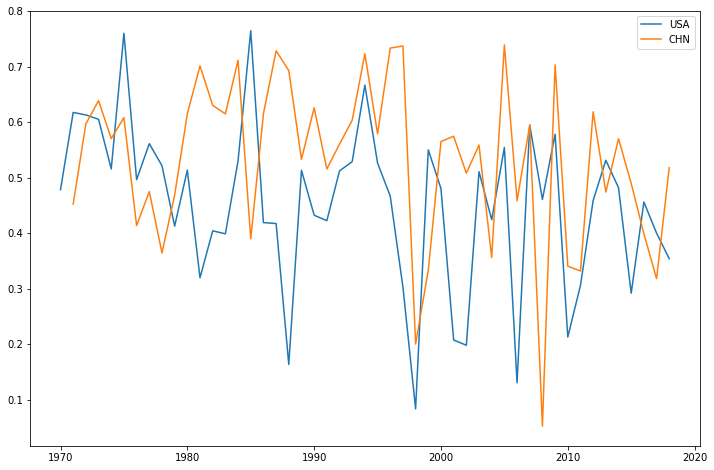

In [129]:
#Plot it
plt.figure(figsize=(12, 8))
for num_con in range(2):
    plt.plot(years, con_dcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con])

plt.legend(loc='best')

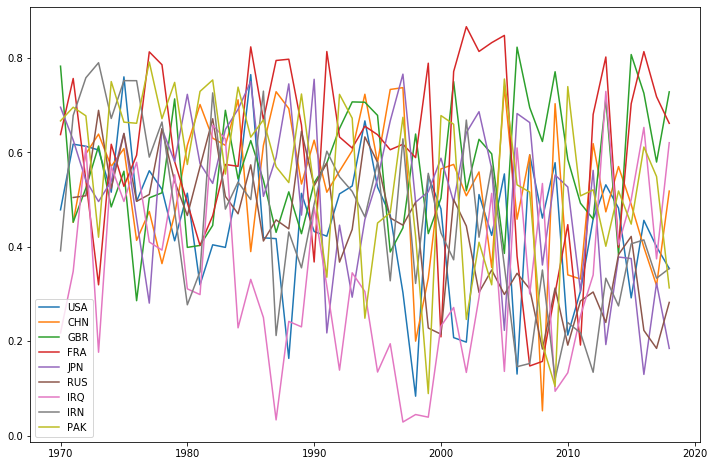

In [130]:
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.plot(years, con_dcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con])

plt.legend(loc='best')

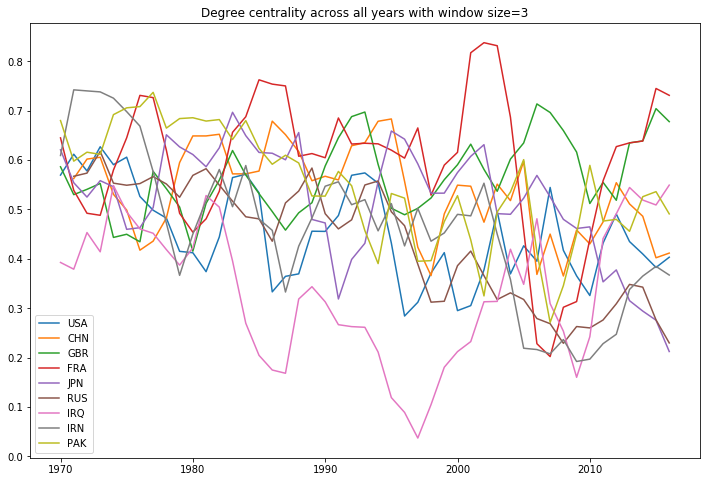

In [156]:
#If we plot this graph using a window of 3 years and the average degree centrality with these three years:
window = 3
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    data_list = list(con_dcen_df.loc[num_con,[*list(years)]])
    window_data_list = []
    for year in range(len(years)-2):
        temp = 0
        for i in range(window):
            temp = temp + data_list[year+i]
        window_data_list.append(temp/window)
    plt.plot(years[0:len(years)-2], window_data_list, label=countries_int[num_con])

plt.title('Degree centrality across all years with window size=3')
plt.legend(loc='best')

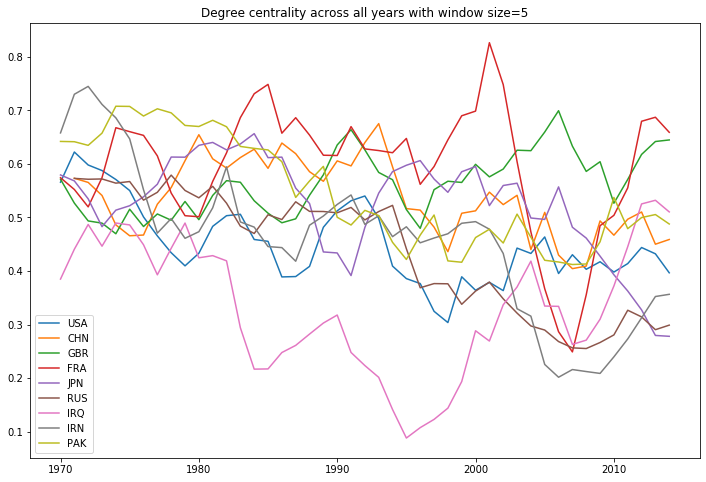

In [155]:
#If we plot this graph using a window of 5 years and the average degree centrality with these three years:
window = 5
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    data_list = list(con_dcen_df.loc[num_con,[*list(years)]])
    window_data_list = []
    for year in range(len(years)-4):
        temp = 0
        for i in range(window):
            temp = temp + data_list[year+i]
        window_data_list.append(temp/window)
    plt.plot(years[0:len(years)-4], window_data_list, label=countries_int[num_con])

plt.title('Degree centrality across all years with window size=5')
plt.legend(loc='best')

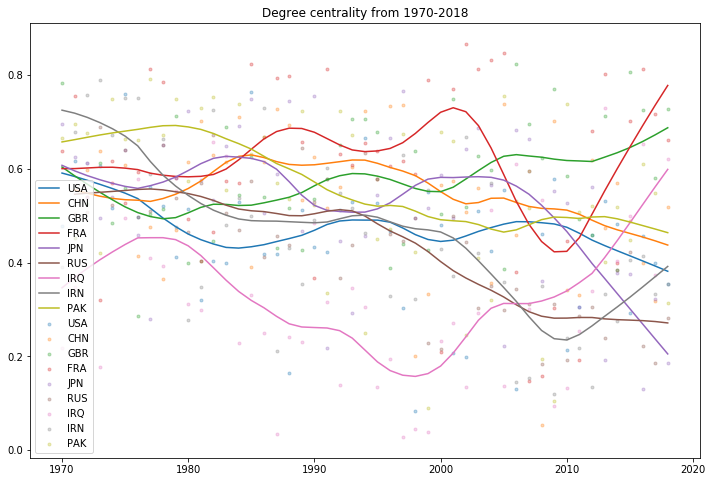

In [179]:
#If we use lowess_smoothing to smooth the curve.
import statsmodels.api as sm

plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.scatter(years, con_dcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con], marker='.', alpha=0.3)
    lowess_smoothing = sm.nonparametric.lowess(con_dcen_df.loc[num_con,[*list(years)]], years, frac=.3)
    lowess_x = list(zip(*lowess_smoothing))[0]
    lowess_y = list(zip(*lowess_smoothing))[1]
    plt.plot(lowess_x, lowess_y, '-', label=countries_int[num_con])

plt.title('Degree centrality from 1970-2018')
plt.legend(loc='best')
plt.savefig('./pic/degree_cen_1970_2018.png', format='PNG')

ii. Betweeness centrality

In [132]:
#Similar methods are used for betweeness centrality as degree centrality. 
#Calculate betweeness centralities for each graph
bcentrality_list = []
country_bcen_df = pd.DataFrame(countries_int, columns = ['country'])
bcen_df = pd.DataFrame(columns=['year', 'Top 10 countries', 'Last 10 countries'])

for num_year in range(len(g_list)):
    dict_cen = {}
    dict_cen['year'] = 1970 + num_year
    
    b_cen = nx.betweenness.betweenness_centrality(g_list[num_year])
    
    #Get the top 10 and last 10 countries by betweeness centrality
    sorted_bcen = {k: v for k, v in sorted(b_cen.items(), key=lambda item: item[1], reverse=True)}
    dict_cen['Top 10 countries'] = list(sorted_bcen.keys())[:10]
    dict_cen['Last 10 countries'] = list(sorted_bcen.keys())[-10:]
    #print(1970+num_year, dict_cen)
    bcen_df = bcen_df.append(dict_cen, ignore_index=True)  

In [133]:
bcen_df

,year,Top 10 countries,Last 10 countries
0,1970,"[GBR, ZAF, LKA, BEL, PAK, CUB, MEX, FRA, THA, ...","[AUT, ISL, ITA, LBR, SGP, DZA, GHA, IRQ, LBN, ..."
1,1971,"[FRA, LUX, AUS, CAF, SOM, LKA, HTI, CHL, CUB, ...","[UKR, JAM, PRY, ISL, ECU, SLV, TTO, BFA, MAR, ..."
2,1972,"[LKA, VEN, CRI, IND, IRN, KHM, BEL, ZAF, RWA, ...","[NIC, NGA, MLI, HND, IRL, FJI, KWT, BFA, POL, ..."
3,1973,"[IRN, CAF, MUS, TUR, OMN, MYS, MRT, SGP, ZAF, ...","[ARG, DNK, BGR, ISL, LBR, GAB, ESP, EGY, IRQ, ..."
4,1974,"[NIC, BFA, PAK, MLI, RWA, LSO, COD, ITA, IRN, ...","[KEN, SWZ, LBR, NLD, CAN, NOR, QAT, UGA, DNK, ..."
5,1975,"[IRN, ECU, MYS, USA, IND, CAF, PRY, CUB, PER, ...","[UGA, SDN, CRI, CAN, GUY, FIN, DZA, PAN, YEM, ..."
6,1976,"[IND, LKA, SUR, SGP, ITA, MDG, LSO, BTN, DOM, ...","[AUS, LBY, MRT, TUR, ISR, GBR, MNG, GRC, PAN, ..."
7,1977,"[FRA, PAK, OMN, ECU, SUR, HTI, KEN, GHA, ZMB, ...","[NGA, VEN, DNK, ETH, MRT, COM, SYC, CHL, TUN, ..."
8,1978,"[FRA, POL, IRL, COD, RUS, TUN, SWE, LKA, GMB, ...","[AUS, VNM, LBN, BFA, PRT, CHL, SGP, CYP, MNG, ..."
9,1979,"[IND, BEL, NER, SLV, TGO, PAK, GRD, BGD, CUB, ...","[ECU, VEN, GTM, WSM, PNG, EGY, TUN, COL, ROU, ..."


In [134]:
dict_con_list=[]

for country in countries_int:
    dict_temp = {}
    dict_temp['country'] = country
    for num_year in range(len(g_list)):
        b_cen = nx.betweenness.betweenness_centrality(g_list[num_year])
        if country in g_list[num_year].nodes():
            dict_temp[num_year+1970] = b_cen[country]
        else:
            dict_temp[num_year+1970] = np.nan
    #print(dict_temp)
    dict_con_list.append(dict_temp)

con_bcen_df = pd.DataFrame(dict_con_list)

In [135]:
con_bcen_df

,country,1970,1971,1972,1973,1974,1975,1976,1977,1978,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,USA,0.002879,0.006214,0.006385,0.005095,0.006164,0.009336,0.003929,0.004617,0.003883,...,0.006382,0.000591,0.000936,0.001483,0.002511,0.002068,0.000610,0.001264,0.001542,0.000341
1,CHN,NaN,0.001793,0.004435,0.005842,0.004801,0.004873,0.004470,0.003557,0.002561,...,0.002607,0.000552,0.000577,0.003295,0.001863,0.003489,0.001443,0.000600,0.001466,0.002670
2,GBR,0.023830,0.005149,0.004843,0.005605,0.003788,0.004669,0.000446,0.001608,0.002608,...,0.005454,0.003940,0.003204,0.001483,0.005280,0.001161,0.010509,0.006281,0.003924,0.003473
3,FRA,0.014972,0.012242,0.004476,0.001717,0.005564,0.002337,0.004518,0.012323,0.010202,...,0.001301,0.003158,0.000249,0.005244,0.009465,0.002606,0.006904,0.009510,0.007341,0.003873
4,JPN,0.013221,0.005199,0.004135,0.001809,0.003480,0.005091,0.003125,0.000232,0.005102,...,0.001667,0.001777,0.000305,0.003168,0.000200,0.000894,0.000929,0.000045,0.001454,0.000594
5,RUS,NaN,0.003409,0.002131,0.007926,0.002103,0.003574,0.002639,0.002606,0.008536,...,0.000896,0.000564,0.001167,0.001054,0.000348,0.000904,0.002424,0.001308,0.000761,0.000931
6,IRQ,0.001746,0.001324,0.005518,0.000364,0.004505,0.002085,0.002101,0.001517,0.001815,...,0.000306,0.000641,0.000691,0.000853,0.004607,0.001153,0.003680,0.005146,0.001846,0.003559
7,IRN,0.003515,0.008327,0.009802,0.017570,0.007577,0.011554,0.006912,0.003565,0.004859,...,0.000252,0.000722,0.000342,0.000106,0.001341,0.000416,0.001762,0.001716,0.000497,0.000599
8,PAK,0.015438,0.007464,0.007805,0.002385,0.010642,0.005537,0.005642,0.011539,0.005901,...,0.000130,0.005945,0.001745,0.001764,0.001573,0.001972,0.002771,0.004072,0.002747,0.003063


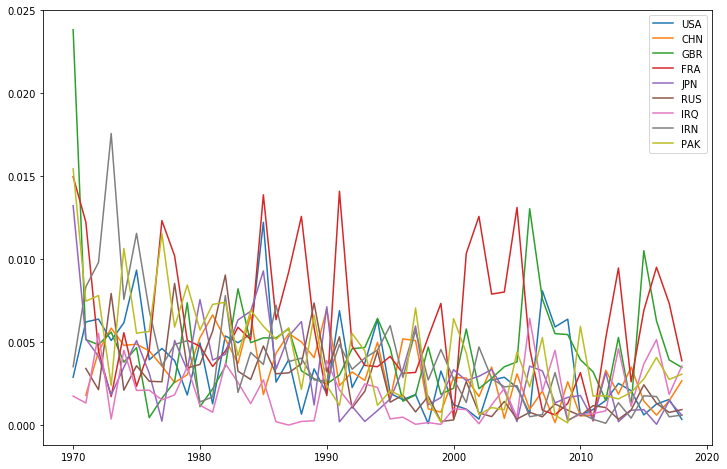

In [136]:
#The plot for betweeness centrality.
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.plot(years, con_bcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con])

plt.legend(loc='best')

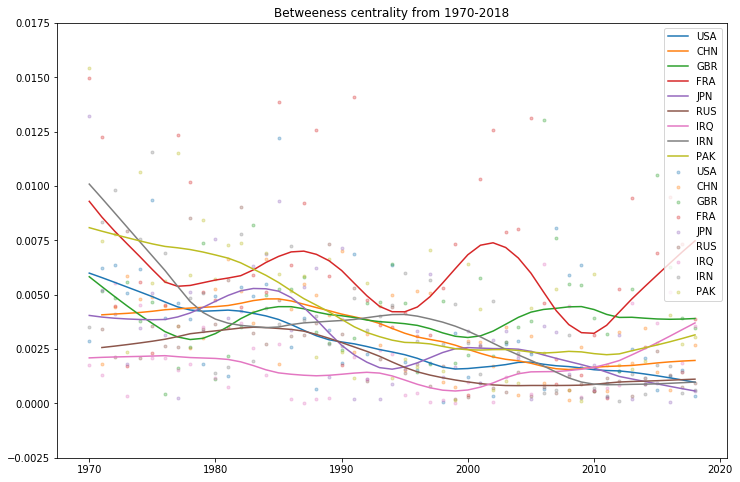

In [166]:
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.scatter(years, con_bcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con], marker='.', alpha=0.3)
    lowess_smoothing = sm.nonparametric.lowess(con_bcen_df.loc[num_con,[*list(years)]], years, frac=.3)
    lowess_x = list(zip(*lowess_smoothing))[0]
    lowess_y = list(zip(*lowess_smoothing))[1]
    plt.plot(lowess_x, lowess_y, '-', label=countries_int[num_con])

plt.ylim(-0.0025, 0.0175)
plt.title('Betweeness centrality from 1970-2018')
plt.legend(loc='best')

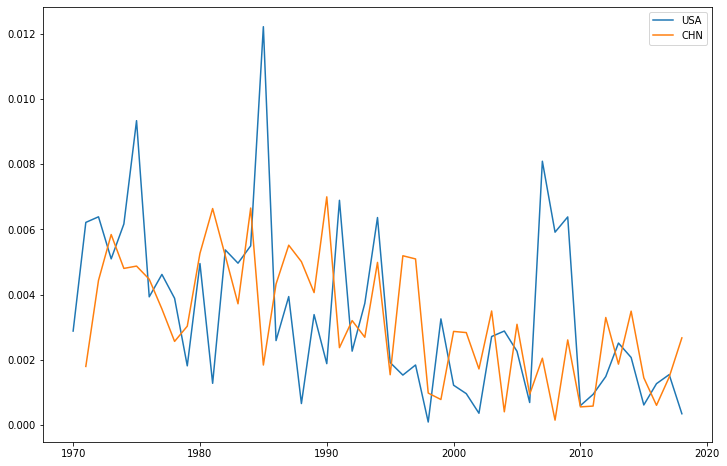

In [138]:
plt.figure(figsize=(12, 8))
for num_con in range(2):
    plt.plot(years, con_bcen_df.loc[num_con,[*list(years)]], label=countries_int[num_con])

plt.legend(loc='best')

iii. Closeness centrality

In [139]:
#Calculate closeness centralities for each graph
bcentrality_list = []
country_ccen_df = pd.DataFrame(countries_int, columns = ['country'])
ccen_df = pd.DataFrame(columns=['year', 'Top 10 countries', 'Last 10 countries'])

for num_year in range(len(g_list)):
    dict_cen = {}
    dict_cen['year'] = 1970 + num_year
    
    c_cen = nx.closeness_centrality(g_list[num_year])
    
    #Get the top 10 and last 10 countries by closeness centrality
    sorted_ccen = {k: v for k, v in sorted(c_cen.items(), key=lambda item: item[1], reverse=True)}
    dict_cen['Top 10 countries'] = list(sorted_ccen.keys())[:10]
    dict_cen['Last 10 countries'] = list(sorted_ccen.keys())[-10:]
    #print(1970+num_year, dict_cen)
    ccen_df = ccen_df.append(dict_cen, ignore_index=True)  

In [140]:
ccen_df

,year,Top 10 countries,Last 10 countries
0,1970,"[GBR, LKA, MEX, BEL, BRA, JPN, CMR, PAK, ZAF, ...","[HND, URY, HTI, GHA, MAR, SYR, DZA, TGO, LBN, ..."
1,1971,"[AUS, FRA, LKA, IND, DZA, NOR, NZL, PAK, LUX, ...","[ECU, GIN, PAN, SLV, PRY, BRA, MAR, CMR, BFA, ..."
2,1972,"[LKA, IND, IRN, HUN, ETH, KHM, LUX, RWA, PAK, ...","[HTI, KWT, UGA, HND, IRL, GUY, NIC, QAT, FJI, ..."
3,1973,"[CAF, IRN, MUS, MYS, MRT, IND, RUS, THA, LKA, ...","[YEM, LBR, ESP, JOR, GUY, SLE, SAU, IRQ, KWT, ..."
4,1974,"[NIC, RWA, PAK, BFA, COD, MLI, ITA, CAF, IND, ...","[TZA, CAN, KEN, MAR, SWZ, QAT, LBR, SAU, UGA, ..."
5,1975,"[MYS, IND, USA, IRN, CAF, POL, SLV, AUS, BGD, ...","[GUY, QAT, IRL, JAM, GRD, BRB, DNK, SDN, UGA, ..."
6,1976,"[IND, BTN, LKA, MYS, IRN, MMR, BGD, SUR, ITA, ...","[COL, MNG, PRT, GRD, FJI, TUR, PAN, PNG, GRC, ..."
7,1977,"[FRA, PAK, OMN, HTI, SUR, ECU, NOR, BWA, GHA, ...","[SGP, ETH, TUN, VEN, NGA, SOM, COM, WSM, CHL, ..."
8,1978,"[POL, FRA, LKA, IRL, ARE, SWE, ECU, TUR, CAF, ...","[JOR, ISL, LBN, BFA, ROU, TTO, PRT, SGP, MNG, ..."
9,1979,"[IND, BEL, PAK, BGD, GBR, SLV, NER, TGO, MYS, ...","[ISR, ROU, GTM, PNG, CAN, FJI, BRB, COL, UGA, ..."


In [141]:
dict_con_list=[]

for country in countries_int:
    dict_temp = {}
    dict_temp['country'] = country
    for num_year in range(len(g_list)):
        c_cen = nx.closeness_centrality(g_list[num_year])
        if country in g_list[num_year].nodes():
            dict_temp[num_year+1970] = c_cen[country]
        else:
            dict_temp[num_year+1970] = np.nan
    #print(dict_temp)
    dict_con_list.append(dict_temp)

con_ccen_df = pd.DataFrame(dict_con_list)

In [142]:
con_ccen_df

,country,1970,1971,1972,1973,1974,1975,1976,1977,1978,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,USA,0.650943,0.723270,0.720930,0.716867,0.673684,0.806452,0.665000,0.695000,0.676329,...,0.703297,0.557864,0.590214,0.648829,0.680851,0.658703,0.585366,0.647651,0.625000,0.605590
1,CHN,NaN,0.646067,0.712644,0.734568,0.699454,0.718391,0.630332,0.655660,0.608696,...,0.768000,0.594937,0.599379,0.723881,0.655290,0.696751,0.662069,0.624595,0.594512,0.672414
2,GBR,0.821429,0.646067,0.677596,0.721212,0.659794,0.694444,0.583333,0.668269,0.673077,...,0.813559,0.706767,0.663230,0.648829,0.777328,0.616613,0.838428,0.784553,0.703971,0.783133
3,FRA,0.734043,0.804196,0.685083,0.595000,0.723164,0.675676,0.711230,0.842424,0.823529,...,0.588957,0.643836,0.551429,0.757812,0.834783,0.624595,0.771084,0.842795,0.780000,0.744275
4,JPN,0.766667,0.727848,0.685083,0.664804,0.684492,0.735294,0.648780,0.579167,0.740741,...,0.688172,0.678700,0.590214,0.695341,0.553314,0.616613,0.615385,0.531680,0.596330,0.541667
5,RUS,NaN,0.668605,0.670270,0.762821,0.677249,0.735294,0.665000,0.671498,0.740741,...,0.592593,0.552941,0.583082,0.589666,0.568047,0.616613,0.633663,0.561047,0.541667,0.580357
6,IRQ,0.552000,0.605263,0.720930,0.543379,0.699454,0.664894,0.700000,0.628959,0.619469,...,0.512000,0.535613,0.571006,0.602484,0.786885,0.624595,0.666667,0.742308,0.615142,0.722222
7,IRN,0.621622,0.756579,0.805195,0.826389,0.752941,0.801282,0.801205,0.709184,0.748663,...,0.521739,0.564565,0.561047,0.525745,0.600000,0.577844,0.627451,0.630719,0.598160,0.605590
8,PAK,0.750000,0.766667,0.756098,0.632979,0.800000,0.748503,0.747191,0.827381,0.752688,...,0.520325,0.793249,0.667820,0.675958,0.625407,0.674825,0.642140,0.720149,0.689046,0.592705


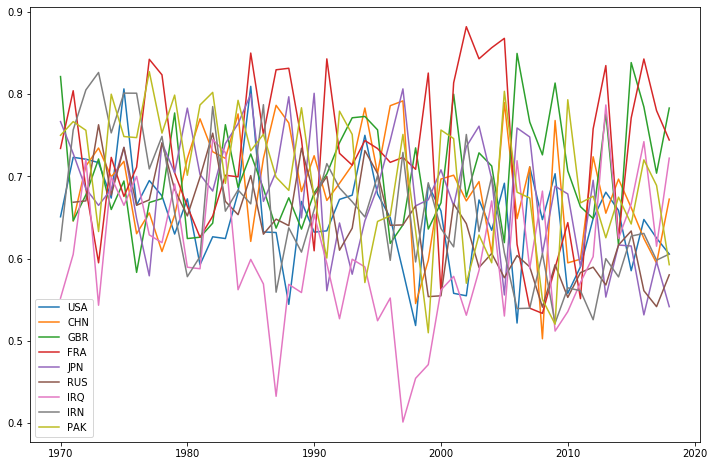

In [144]:
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.plot(years, con_ccen_df.loc[num_con,[*list(years)]], label=countries_int[num_con])

plt.legend(loc='best')

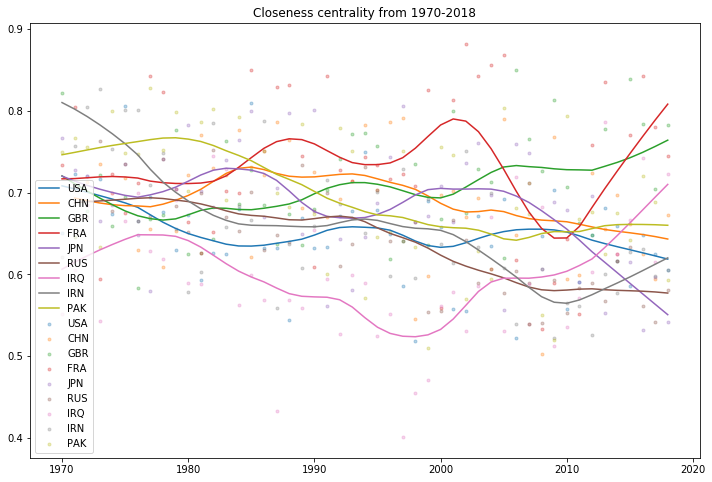

In [167]:
plt.figure(figsize=(12, 8))
for num_con in range(len(countries_int)):
    plt.scatter(years, con_ccen_df.loc[num_con,[*list(years)]], label=countries_int[num_con], marker='.', alpha=0.3)
    lowess_smoothing = sm.nonparametric.lowess(con_ccen_df.loc[num_con,[*list(years)]], years, frac=.3)
    lowess_x = list(zip(*lowess_smoothing))[0]
    lowess_y = list(zip(*lowess_smoothing))[1]
    plt.plot(lowess_x, lowess_y, '-', label=countries_int[num_con])

plt.title('Closeness centrality from 1970-2018')
plt.legend(loc='best')

#### d. Using pyLDAvis to visualize topics

In [169]:
import pyLDAvis.gensim

pyLDAvis.gensim.prepare(unlda_opt, corpus, dict_all)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5     -0.017563  0.008790       1        1  21.331871
17     0.039097 -0.000679       2        1   7.396034
7      0.023795  0.018556       3        1   7.117557
1     -0.008598 -0.010193       4        1   5.647276
6      0.056391  0.000096       5        1   5.236053
10     0.054185 -0.011516       6        1   5.123336
22     0.075533  0.010221       7        1   4.716917
21    -0.017617 -0.050453       8        1   4.204391
26    -0.038455  0.015661       9        1   3.869181
23    -0.058580 -0.050300      10        1   3.519432
20     0.000086  0.019274      11        1   3.438844
19     0.047615 -0.001196      12        1   3.160251
8     -0.010813  0.028351      13        1   2.912843
3      0.023452 -0.012006      14        1   2.878255
2     -0.046005 -0.111514      15        1   2.839149
15     0.120036  0.023218      16        1   2.521585
11     0.022859 -0.049320      17        1   2.248765
18    -0.010818  0.003032      18        1   1.943743
12    -0.001024  0.012738      19        1   1.365288
4     -0.037040  0.022706      20        1   1.253012
25    -0.033511  0.053407      21        1   1.168938
27     0.021348  0.023351      22        1   1.079025
14    -0.025964  0.002277      23        1   1.025417
9      0.001260  0.005200      24        1   0.993064
16    -0.008372 -0.055333      25        1   0.937087
24    -0.085787  0.085730      26        1   0.748586
13    -0.057774  0.006902      27        1   0.723767
0     -0.027733  0.013001      28        1   0.600334, topic_info=     Category           Freq    Term          Total  loglift  logprob
868   Default  139838.000000   unite  139838.000000  30.0000  30.0000
535   Default  145181.000000  nation  145181.000000  29.0000  29.0000
5639  Default    4687.000000   sudan    4687.000000  28.0000  28.0000
1155  Default    9248.000000  island    9248.000000  27.0000  27.0000
470   Default    6282.000000   korea    6282.000000  26.0000  26.0000
...       ...            ...     ...            ...      ...      ...
125   Topic28      89.953178   cause   13490.709961   0.1050  -6.0955
1373  Topic28      95.286011  weapon   18091.437500  -0.1309  -6.0379
739   Topic28      82.369583    seek   11246.685547   0.1988  -6.1835
478   Topic28      84.418976    lead   16460.587891  -0.1575  -6.1590
397   Topic28      83.354446    hold   16002.255859  -0.1419  -6.1717

[1992 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
9148      1  0.926951  12-month
6141      1  0.863181      15th
6141      2  0.030828      15th
6141      5  0.030828      15th
6141      9  0.030828      15th
...     ...       ...       ...
2405     24  0.005024  zimbabwe
2405     25  0.006531  zimbabwe
2405     26  0.003014  zimbabwe
2405     27  0.007034  zimbabwe
2405     28  0.009043  zimbabwe

[23108 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 18, 8, 2, 7, 11, 23, 22, 27, 24, 21, 20, 9, 4, 3, 16, 12, 19, 13, 5, 26, 28, 15, 10, 17, 25, 14, 1])